<a href="https://colab.research.google.com/github/fbeilstein/machine_learning/blob/master/gallery.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Lecture ?? "Statistics"

In [0]:
#@title #Bernoulli distribution
from scipy.stats import bernoulli, binom, poisson
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets

# Properties for plots
plt.style.use([{
    "figure.figsize":(12,9), # Figure size
    "xtick.labelsize": "large", # Font size of the X-ticks
    "ytick.labelsize": "large", # Font size of the Y-ticks
    "legend.fontsize": "x-large", # Font size of the legend
    "axes.labelsize": "x-large", # Font size of labels
    "axes.titlesize": "xx-large", # Font size of title
    "axes.spines.top": False,
    "axes.spines.right": False,
},'seaborn-poster'])

@widgets.interact(n=(0,30), p=(0.0,1.0), samples=(1,1000), continuous_update=False)
def plot_pmf(n, p, samples=100, histogram=False):
    k = np.arange(0, n + 1)
    P_binom = binom.pmf(k, n, p)
    plt.plot(k, P_binom, '-o', color='r')
    if histogram:
        height,y = np.histogram(binom.rvs(size=samples, n=n, p=p), range=(0,n), bins=n+1, density=True)
        plt.bar(k,height,color='b')
    plt.title('PMF of Bin(%i, %.2f)' % (n, p))
    plt.xlabel('k')
    plt.ylabel('$B_{%i, %.2f}(k)$' % (n, p))
    plt.show()

interactive(children=(IntSlider(value=15, description='n', max=30), FloatSlider(value=0.5, description='p', ma…

In [0]:
#@title #Poisson distribution

from scipy.stats import bernoulli, binom, poisson
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets

# Properties for plots
plt.style.use([{
    "figure.figsize":(12,9), # Figure size
    "xtick.labelsize": "large", # Font size of the X-ticks
    "ytick.labelsize": "large", # Font size of the Y-ticks
    "legend.fontsize": "x-large", # Font size of the legend
    "axes.labelsize": "x-large", # Font size of labels
    "axes.titlesize": "xx-large", # Font size of title
    "axes.spines.top": False,
    "axes.spines.right": False,
},'seaborn-poster'])

@widgets.interact(n=(0,50),samples=(1,1000),λ=(0.0,30.0))
def f(n, λ, samples=100,histogram=False):
    k = np.arange(0, n+1)
    P_poisson = poisson.pmf(k, λ)
    plt.plot(k, P_poisson, '-o', color='r')
    if histogram:
        height,y = np.histogram(poisson.rvs(size=samples,mu=λ), range=(0,n), bins=n+1, density=True)
        plt.bar(k,height,color='b')
    plt.title('PMF of Poisson(%i)' %λ)
    plt.xlabel('Number of Events')
    plt.ylabel('Probability of Number of Events')
    plt.show()

interactive(children=(IntSlider(value=25, description='n', max=50), FloatSlider(value=15.0, description='λ', m…

In [0]:
#@title #Exponential distribution

import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets
import scipy.stats

# Properties for plots
plt.style.use([{
    "figure.figsize":(12,9), # Figure size
    "xtick.labelsize": "large", # Font size of the X-ticks
    "ytick.labelsize": "large", # Font size of the Y-ticks
    "legend.fontsize": "x-large", # Font size of the legend
    "axes.labelsize": "x-large", # Font size of labels
    "axes.titlesize": "xx-large", # Font size of title
    "axes.spines.top": False,
    "axes.spines.right": False,
},'seaborn-poster'])

@widgets.interact(lam=(0.01,10.0,0.01), SampleSize=(1,1000), continous_update=False)
def f(lam, SampleSize=100, histogram=False):
  x_max = 40
  x = np.arange(0, x_max, x_max/1000)
  y = lam*np.exp(-lam*x)
  z = 1 - np.exp(-lam*x)
  # Plot the PDF
  plt.plot(x, y, linewidth = 3.0, label = 'PDF')
  if histogram:
   samples = scipy.stats.expon.rvs(1/lam, size=SampleSize)
   plt.hist(samples, bins=30, density=True)
  plt.xlim([0,x_max])
  plt.title("Exponential({})".format(lam))
  plt.xlabel('x')
  plt.ylabel('y')
  plt.legend()
  plt.show()

interactive(children=(FloatSlider(value=5.0, description='lam', max=10.0, min=0.01, step=0.01), IntSlider(valu…

In [0]:
#@title #Normal distribution
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets
import scipy.stats

# Properties for plots
plt.style.use([{
    "figure.figsize":(12,9), # Figure size
    "xtick.labelsize": "large", # Font size of the X-ticks
    "ytick.labelsize": "large", # Font size of the Y-ticks
    "legend.fontsize": "x-large", # Font size of the legend
    "axes.labelsize": "x-large", # Font size of labels
    "axes.titlesize": "xx-large", # Font size of title
    "axes.spines.top": False,
    "axes.spines.right": False,
},'seaborn-poster'])

# Plots pdf of a normal distribution
@widgets.interact(mu=(-25.0,25.0), var=(0.3,30.0))
def plot_pdf(mu, var):
    '''
    Takes mean, variance, range of x and y axes, and whether CDF desired.
    Plots PDF, and optionally CDF.
    '''
    x = np.linspace(-50, 50, 1001)
    sig = var**0.5
    P_norm = scipy.stats.norm.pdf(x, mu, sig)
    
    plt.plot(x, P_norm, 'b', linewidth=3.0, label = "PDF")
    y0 = (1/(sig*np.sqrt(2*np.pi)))*np.exp(-0.5)
    ym = 1/(sig*np.sqrt(2*np.pi))
    plt.plot([mu-sig, mu-sig], [0, y0], 'm--',linewidth = 2.0)
    plt.plot([mu+sig, mu+sig], [0, y0], 'm--', linewidth = 2.0, label = '$\mu\pm\sigma$')
    plt.plot([mu,mu], [0,ym], 'g--', linewidth = 2.0, label = r'$\mu$')
    
    plt.title('PDF of N({},{})'.format(mu,var))
    plt.xlabel('x')
    plt.ylabel('y')
    plt.legend()
    plt.show()

interactive(children=(FloatSlider(value=0.0, description='mu', max=25.0, min=-25.0), FloatSlider(value=15.15, …

In [0]:
#@title Mean of sample and population

###### EXAMPLE ######
#
# Estimating mean value of the population
# 1. See that different samples have different means
# 2. See that estimator has its own distribution
# 3. See how distribution changes with size of samples
#
#####################

import itertools
import statistics
import matplotlib.pyplot as plt

import ipywidgets as widgets
import numpy as np

def generate_histogram(size):
  all_sums = {e:1 for e in population}
  for _ in range(size-1):
    tmp = {}
    for el in population:
      for sum_,cnt_ in all_sums.items():
        s = sum_ + el
        if s in tmp:
          tmp[s] += cnt_
        else:
          tmp[s] = cnt_
    all_sums = tmp
  all_means = [s/size for s in all_sums.keys()]
  norm = size / sum(all_sums.values())
  heights = [s*norm for s in all_sums.values()]
  return all_means, heights


population = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

def plot_histos(size1, size2):
  plt.figure(figsize=(10,8))
  sample1_bins, sample1_heights = generate_histogram(size1)
  plt.bar(sample1_bins, sample1_heights, alpha=0.5, width=1/size1)
  sample2_bins, sample2_heights = generate_histogram(size2)
  plt.bar(sample2_bins, sample2_heights, alpha=0.5, width=1/size2)
  h = np.max([np.max(sample2_heights), np.max(sample1_heights)])
  plt.plot([np.mean(population), np.mean(population)], [0, h], 'm--',linewidth = 2.0)
  plt.xlabel('mean of a sample', fontsize=16)
  plt.ylabel('probability', fontsize=16)
  plt.title('probabilities to get different means', fontsize=20)
  plt.legend(["true mean", "sample 1", "sample 2"], loc=2)
  

slider_sample_1 = widgets.IntSlider(min=1, max=10, value=1, description='sample 1 size')
slider_sample_2 = widgets.IntSlider(min=1, max=10, value=2, description='sample 2 size')

widgets.interact(plot_histos, size1=slider_sample_1, size2=slider_sample_2);

interactive(children=(IntSlider(value=1, description='sample 1 size', max=10, min=1), IntSlider(value=2, descr…

In [0]:
#@title #Sample variance for normal distribution
import ipywidgets as widgets
import matplotlib.pyplot as plt
import numpy as np

@widgets.interact(n=(2, 20))
def Normal_Variance(n):
# n: sample size
# s: number of experiments
# ddof: degree of freedom
#     ddof=0: calculate "raw" variance 
#     ddof=1: calculate unbiased variance 
    plt.figure(figsize=(12, 8))
    plt.xlim([0, 4])
    
    s = 1000000
    X = np.random.normal(0, 1, [n,s])
    
    V = np.var(X, axis=0, ddof=0)
    v = np.mean(V)
    Vu = np.var(X, axis=0, ddof=1)
    vu = np.mean(Vu)
    
    
    counts, bins, bars = plt.hist(V, bins=60, density=True, alpha=0.5);
    h = np.max(counts)
    counts, bins, bars = plt.hist(Vu, bins=60, density=True, alpha=0.5);
    hu = np.max(counts)
    plt.plot([v,v], [0, np.max([h, hu])], 'r--', linewidth = 2.0)
    plt.plot([vu,vu], [0, np.max([h, hu])], 'b-', linewidth = 1.0)

    plt.plot([1,1], [0, np.max([h, hu])], 'g:', linewidth = 3.0)
    plt.ylabel('frequency', fontsize = 15)
    plt.grid()
    plt.title('histogram of sample variances with sample size n=%d'%n, fontsize = 15)
    plt.xlabel('Sample Variance', fontsize = 15)
    plt.legend(['biased variance', 'unbiased variance', 'population variance', 'biased variances', 'unbiased variances'])
    
    ax2 = plt.axes([0.65, 0.2, 0.2, 0.4])
    x = np.linspace(-8, 8, 1001)
    P_norm = scipy.stats.norm.pdf(x, 0, 1)
    ax2.plot(x, P_norm)
    plt.title("Population distribution")

interactive(children=(IntSlider(value=11, description='n', max=20, min=2), Output()), _dom_classes=('widget-in…

In [0]:
#@title #Correcting standart deviation for normal distribution

import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets
import scipy
import scipy.stats

def Normal_SD(n, d):
# n: sample size
# s: number of experiments

    plt.figure(figsize=(12,8))
    plt.xlim([0,3])
    plt.title('histogram of sample standard deviation with sample size n=%d'%n, fontsize = 15)
    plt.xlabel('$\hat{\sigma}$', fontsize = 15)
    
    s = 1000000
    X = np.random.normal(0, 1, [n, s])
    V = np.sqrt(np.var(X, axis=0, ddof=d))
    v = np.mean(V)
    
    plt.plot([v,v], [0, 2], 'r--', linewidth = 2.0)
    plt.hist(V, bins=60, density=True);

    plt.plot([1,1], [0, 2], 'g:', linewidth = 2.0)
    plt.ylabel('frequency', fontsize = 15)
    plt.grid() 
    
    plt.legend(["estimated $\sigma$", "true $\sigma$", "$\sigma$ histogram" ])
    
    ax2 = plt.axes([0.65, 0.3, 0.2, 0.4])
    x = np.linspace(-10, 10, 1001)
    P_norm = scipy.stats.norm.pdf(x, 0, 1)
    ax2.plot(x, P_norm)
    plt.title("Population distribution")
    
    
widgets.interact(Normal_SD,
    n = widgets.IntSlider(min=2, max=10, description='n=', step=1, value=2),
    d = widgets.FloatSlider(min=-1.0, max=2.0, description='d=', value=0.0));

interactive(children=(IntSlider(value=2, description='n=', max=10, min=2), FloatSlider(value=0.0, description=…

In [0]:
#@title #MLE for gaussian with fixed dispersion
from scipy.stats import bernoulli, binom, poisson
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets
import scipy

# Properties for plots
plt.style.use([{
    "figure.figsize":(12,9), # Figure size
    "xtick.labelsize": "large", # Font size of the X-ticks
    "ytick.labelsize": "large", # Font size of the Y-ticks
    "legend.fontsize": "x-large", # Font size of the legend
    "axes.labelsize": "x-large", # Font size of labels
    "axes.titlesize": "xx-large", # Font size of title
    "axes.spines.top": False,
    "axes.spines.right": False,
},'seaborn-poster'])


def generate_sample(var, mu, sample_size):
  sig = np.sqrt(var)
  return scipy.stats.norm.rvs(mu, sig, size=sample_size)

def plot_sample(sample):
  plt.plot(sample, np.zeros_like(sample), 'o', color='r', alpha=0.8)

def plot_norm_distribution(var, mu, color='b'):
  x = np.linspace(-50, 50, 1001)
  sig = np.sqrt(var)
  y = scipy.stats.norm.pdf(x, mu, sig)
  plt.plot(x, y, color, linewidth=3.0)

def plot_sampled(var, mu, sample):
  sig = np.sqrt(var)
  y = scipy.stats.norm.pdf(sample, mu, sig)
  for x_, y_ in zip(sample, y):
    plt.plot([x_, x_], [0, y_], 'm--',linewidth = 2.0)
  plt.plot(sample, y, 'o', color='b', alpha=1.0)
  
def get_likelihood(sample, mu, var):
  sig = np.sqrt(var)
  return np.sum(np.log(scipy.stats.norm.pdf(sample, mu, sig)))

def plot_likelihoods(sample, var):
  mu = np.linspace(-50, 50, 1001)
  l = [get_likelihood(sample, mu_, var) for mu_ in mu]
  plt.plot(mu, l, 'b', linewidth=3.0)


var = 160.0
mu = 0.0
old_sample_size = 1
sample = np.array([])

button = widgets.Button(value=False, description='Generate sample', icon='check')
slider_mu = widgets.FloatSlider(min=-50.0, max=50.0, value=0.0, description='mu')
slider_sample = widgets.IntSlider(min=1, max=30, value=3, description='sample size')


@button.on_click
def plot_on_click(b):
  global sample
  sample = generate_sample(var, mu, old_sample_size)
  if slider_mu.value > 0.0:
    slider_mu.value = slider_mu.value - 1E-10
  else: 
    slider_mu.value = slider_mu.value + 1E-10

def plot_likelihood_estimator(mu_test, sample_size):
  global old_sample_size
  global sample
  if old_sample_size != sample_size:
    sample = generate_sample(var, mu, sample_size)
    old_sample_size = sample_size

  plt.subplot(1, 2, 1)
  plt.title('PDF')
  plot_sample(sample)
  plot_norm_distribution(var, mu_test)
  plot_norm_distribution(var, mu, color='r')
  plot_sampled(var, mu_test, sample)

  plt.subplot(1, 2, 2)
  plt.title('Log of likelihood')
  plot_likelihoods(sample, var)
  plt.plot(mu_test, get_likelihood(sample, mu_test, var), 'o', color='b', alpha=1.0);


display(button)
widgets.interact(plot_likelihood_estimator, mu_test=slider_mu, sample_size=slider_sample);  

Button(description='Generate sample', icon='check', style=ButtonStyle())

interactive(children=(FloatSlider(value=0.0, description='mu', max=50.0, min=-50.0), IntSlider(value=3, descri…

In [0]:
#@title #MLE for gaussian with fixed mean
from scipy.stats import bernoulli, binom, poisson
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets
import scipy

# Properties for plots
plt.style.use([{
    "figure.figsize":(12,9), # Figure size
    "xtick.labelsize": "large", # Font size of the X-ticks
    "ytick.labelsize": "large", # Font size of the Y-ticks
    "legend.fontsize": "x-large", # Font size of the legend
    "axes.labelsize": "x-large", # Font size of labels
    "axes.titlesize": "xx-large", # Font size of title
    "axes.spines.top": False,
    "axes.spines.right": False,
},'seaborn-poster'])


def generate_sample(sig, mu, sample_size):
  return scipy.stats.norm.rvs(mu, sig, size=sample_size)

def plot_sample(sample):
  plt.plot(sample, np.zeros_like(sample), 'o', color='r', alpha=0.8)

def plot_norm_distribution(sig, mu, color='b'):
  x = np.linspace(-50, 50, 1001)
  y = scipy.stats.norm.pdf(x, mu, sig)
  plt.plot(x, y, color, linewidth=3.0)

def plot_sampled(sig, mu, sample):
  y = scipy.stats.norm.pdf(sample, mu, sig)
  for x_, y_ in zip(sample, y):
    plt.plot([x_, x_], [0, y_], 'm--',linewidth = 2.0)
  plt.plot(sample, y, 'o', color='b', alpha=1.0)
  
def get_likelihood(sample, mu, sig):
  return np.prod((scipy.stats.norm.pdf(sample, mu, sig)))

def plot_likelihoods(sample, mu):
  sig = np.linspace(0.1, 100, 1001)
  l = [get_likelihood(sample, mu, sig_) for sig_ in sig]
  plt.plot(sig, l, 'b', linewidth=3.0)


sig = 10.0
mu = 0.0
old_sample_size = 1
sample = np.array([])

button = widgets.Button(value=False, description='Generate sample', icon='check')
slider_sig = widgets.FloatSlider(min=0.1, max=30.0, value=0.1, description='sigma')
slider_sample = widgets.IntSlider(min=1, max=30, value=3, description='sample size')


@button.on_click
def plot_on_click(b):
  global sample
  sample = generate_sample(sig, mu, old_sample_size)
  if slider_sig.value > 10.0:
    slider_sig.value = slider_sig.value - 1E-10
  else: 
    slider_sig.value = slider_sig.value + 1E-10

def plot_likelihood_estimator(sig_test, sample_size):
  global old_sample_size
  global sample
  if old_sample_size != sample_size:
    sample = generate_sample(sig, mu, sample_size)
    old_sample_size = sample_size

  plt.subplot(1, 2, 1)
  plt.title('PDF')
  plot_sample(sample)
  plot_norm_distribution(sig_test, mu)
  plot_norm_distribution(sig, mu, color='r')
  plot_sampled(sig_test, mu, sample)

  plt.subplot(1, 2, 2)
  plt.title('Likelihood')
  plot_likelihoods(sample, mu)
  plt.plot(sig_test, get_likelihood(sample, mu, sig_test), 'o', color='b', alpha=1.0);


display(button)
widgets.interact(plot_likelihood_estimator, sig_test=slider_sig, sample_size=slider_sample);  



Button(description='Generate sample', icon='check', style=ButtonStyle())

interactive(children=(FloatSlider(value=0.1, description='sigma', max=30.0, min=0.1), IntSlider(value=3, descr…

In [0]:
#@title #Correlation coefficient

import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 9.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = 'rgba(200, 0, 0, 0.65)';
      ctx.fill();
    }
    
    function mean(idx) {
      var sum = 0.0;
      var num = 0;
      if (active_pt && active_pt[0] > 0 && active_pt[0] < 600 && active_pt[1] > 0 && active_pt[1] < 600) {
        sum = active_pt[idx];
        num = 1;
      }
      all_pts.forEach(function (item, index) {
          sum += item[idx];
          num += 1;
        });
      return sum / num;
    }

    function correlation(m_x, m_y) {
      cov_xy = 0.0;
      s_x2 = 0.0;
      s_y2 = 0.0;
      if (active_pt && active_pt[0] > 0 && active_pt[0] < 600 && active_pt[1] > 0 && active_pt[1] < 600) {
        dx = active_pt[0] - m_x;
        dy = active_pt[1] - m_y;
        cov_xy = dx * dy;
        s_x2 = dx * dx;
        s_y2 = dy * dy;
      }
      all_pts.forEach(function (item, index) {
          dx = item[0] - m_x;
          dy = item[1] - m_y;
          cov_xy += dx * dy;
          s_x2 += dx * dx;
          s_y2 += dy * dy;
        });
      return - cov_xy / Math.sqrt(s_x2 * s_y2);
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText('Feature', 670, 105);
        ctx.fillText('Correlation: ', 650, 200);
        ctx.fillText(debug_txt, 200, 200);
        circ(ctx, classAbtn);
        ctx.strokeRect(625, 75, 150, 50);
        ctx.strokeRect(625, 175, 150, 50);

        var m_x = mean(0);
        var m_y = mean(1);
        ctx.fillStyle = 'rgba(0, 0, 200, 0.3)';
        ctx.fillRect(m_x, m_y, 600-m_x, 600-m_y);
        ctx.fillRect(0, 0, m_x, m_y);
        ctx.fillStyle = 'rgba(200, 0, 0, 0.2)';
        ctx.fillRect(m_x, 0, 600-m_x, m_y);
        ctx.fillRect(0, m_y, m_x, 600-m_y);

        var corr = correlation(m_x, m_y);
        ctx.fillStyle = 'black';
        ctx.fillText(corr.toFixed(5), 650, 220);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]]);
        });
        
      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (is_close([x,y], classAbtn)) {
        active_pt = [x, y]
      }
      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <script> init();</script>
'''

  
display(IPython.display.HTML(main_str))

In [0]:
#@title #Simpson Paradox

import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 9.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = (cls == 0 ? 'rgba(200, 0, 0, 0.5)' : 'rgba(0, 0, 200, 0.5)');
      ctx.fill();
    }

    function in_rect(pos, rect) {
      if (pos[0] < rect[0] || pos[0] > (rect[0] + rect[2]))
        return false;
      if (pos[1] < rect[1] || pos[1] > (rect[1] + rect[3]))
        return false;
      return true;
    }

    function get_survivals() {
      var g1A = [0, 0];
      var g1B = [0, 0];
      var g2A = [0, 0];
      var g2B = [0, 0];
      all_pts.forEach(function (item, index) {
        if (in_rect(item, [0, 100, 200, 250]))
          g1A[item[2]] += 1;
        if (in_rect(item, [400, 100, 200, 250]))
          g1B[item[2]] += 1;
        if (in_rect(item, [0, 350, 200, 250]))
          g2A[item[2]] += 1;
        if (in_rect(item, [400, 350, 200, 250]))
          g2B[item[2]] += 1;
      });
        if (active_pt && in_rect(active_pt, [0, 100, 200, 250]))
          g1A[active_pt[2]] += 1;
        if (active_pt && in_rect(active_pt, [400, 100, 200, 250]))
          g1B[active_pt[2]] += 1;
        if (active_pt && in_rect(active_pt, [0, 350, 200, 250]))
          g2A[active_pt[2]] += 1;
        if (active_pt && in_rect(active_pt, [400, 350, 200, 250]))
          g2B[active_pt[2]] += 1;      
      return [g1A[0]/(g1A[0]+g1A[1]), 
              g1B[0]/(g1B[0]+g1B[1]), 
              g2A[0]/(g2A[0]+g2A[1]), 
              g2B[0]/(g2B[0]+g2B[1]),
              (g1A[0] + g2A[0])/(g1A[0]+g1A[1]+g2A[0]+g2A[1]),
              (g1B[0] + g2B[0])/(g1B[0]+g1B[1]+g2B[0]+g2B[1])];
    }

    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.strokeRect(0, 0, 600, 600); // field
        ctx.strokeRect(0, 100, 200, 250);
        ctx.strokeRect(400, 100, 200, 250);
        ctx.strokeRect(0, 350, 200, 250);
        ctx.strokeRect(400, 350, 200, 250);

        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText('Group 1', 50, 150);
        ctx.fillText('Group 2', 50, 400);
        ctx.fillText('Group 1', 450, 150);
        ctx.fillText('Group 2', 450, 400);
        ctx.fillText('Alive', 670, 105);
        ctx.fillText('Dead', 670, 206);
        ctx.fillText('Survival', 210, 200);
        ctx.fillText('Survival', 320, 200);
        ctx.fillText('Survival', 210, 450);
        ctx.fillText('Survival', 320, 450);

        var s = get_survivals();
        ctx.fillText((s[0]*100.0).toFixed(1) + '%', 210, 220);
        ctx.fillText((s[2]*100.0).toFixed(1) + '%', 210, 470);
        ctx.fillText((s[1]*100.0).toFixed(1) + '%', 320, 220);
        ctx.fillText((s[3]*100.0).toFixed(1) + '%', 320, 470);
        ctx.fillText('Hospital A, Survival:'+(s[4]*100.0).toFixed(1) + '%', 50, 50);
        ctx.fillText('Hospital B, Survival:'+(s[5]*100.0).toFixed(1) + '%', 350, 50);

        ctx.font = '40px serif';
        ctx.fillStyle = 'black';
        if (s[0] > s[1])
        	ctx.fillText('>', 290, 220);
        if (s[0] < s[1])
        	ctx.fillText('<', 290, 220);
        if (s[0] == s[1])
        	ctx.fillText('=', 290, 220);
        if (s[2] > s[3])
        	ctx.fillText('>', 290, 470);
        if (s[2] < s[3])
        	ctx.fillText('<', 290, 470);
        if (s[2] == s[3])
        	ctx.fillText('=', 290, 470);
        if (s[4] > s[5])
        	ctx.fillText('>', 290, 50);
        if (s[4] < s[5])
        	ctx.fillText('<', 290, 50);
        if (s[4] == s[5])
        	ctx.fillText('=', 290, 50);

        ctx.fillText(debug_txt, 200, 200);
        circ(ctx, classAbtn, 0);
        circ(ctx, classBbtn, 1);
        ctx.strokeRect(625, 75, 150, 50);
        ctx.strokeRect(625, 175, 150, 50);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });
        
      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (is_close([x,y], classAbtn)) {
        active_pt = [x, y, 0]
      }
      if (is_close([x,y], classBbtn)) {
        active_pt = [x, y, 1]
      }
      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (!in_rect([x,y], [0, 100, 200, 500]) && !in_rect([x,y], [400, 100, 200, 500])) {
        active_pt = null;
      }      
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <script> init();</script>
'''

  
display(IPython.display.HTML(main_str))

#Lecture ?? "Naive Bayes Classification"

In [0]:
#@title #Monty Hall paradox
import IPython
from google.colab import output

main_str = '''
<html>
<head>
<style type="text/css">
img {
        height: 450px;
        width: 220px;
        float:left;
}
</style>
<script type="text/javascript">

tempImg = new Image()
tempImg.src = "https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_5.png"

var state = 0;
var prize = Math.floor(Math.random() * 3) + 1;
var stay = 0;
var change = 0;

var stay_correct = 0;
var stay_incorrect = 0;
var change_correct = 0;
var change_incorrect = 0;

function click_img(num) {
  if (state == 0) {
    let intersection = [1, 2, 3].filter(x => ![num, prize].includes(x));
    var open = intersection[Math.floor(Math.random() * intersection.length)];
    stay = num;
    change = [1, 2, 3].filter(x => ![open, stay].includes(x))[0];
    //document.getElementById("stay_incorrect").innerHTML = "c:" + change + ", o:" + open + ",s:" + stay + ",P:" + prize + "," + intersection;
    
    document.getElementById("d" + open).src = "https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/nb_6.png";
    document.getElementById("d" + stay).src = "https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_2.png";
    document.getElementById("d" + change).src = "https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_3.png";
    state = 1;
  } else if (state == 1 && (num == stay || num == change)) {
    for (var i = 1; i < 4; ++i)
      document.getElementById("d" + i).src = "https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/nb_6.png";
    document.getElementById("d" + prize).src = "https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_5.png";
    if (num == prize && num == stay) stay_correct += 1;
    if (num == prize && num == change) change_correct += 1;
    if (num != prize && num == stay) stay_incorrect += 1;
    if (num != prize && num == change) change_incorrect += 1;

    document.getElementById("switch_correct").innerHTML = change_correct;
    document.getElementById("stay_correct").innerHTML = stay_correct;
    document.getElementById("switch_incorrect").innerHTML = change_incorrect;
    document.getElementById("stay_incorrect").innerHTML = stay_incorrect;
    document.getElementById("switch_proportion").innerHTML = Math.round((change_correct/(change_correct + change_incorrect + 0.000001))*1000)/1000;
    document.getElementById("stay_proportion").innerHTML = Math.round((stay_correct/(stay_correct + stay_incorrect + 0.000001))*1000)/1000;
    state = 2;
  } else if (state == 2) {
    for (var i = 1; i < 4; ++i)
      document.getElementById("d" + i).src = "https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_1.png";
    prize = Math.floor(Math.random() * 3) + 1;
    state = 0;
  }
}

</script>
</head>

<body onload="getImages()">

<table>
<tr>
  <td><img src="https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_1.png" id = "d1" onclick="click_img(1)"></td>
  <td><img src="https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_1.png" id = "d2" onclick="click_img(2)"></td>
  <td><img src="https://raw.githubusercontent.com/fbeilstein/machine_learning/master/lecture_5_naive_bayes/mh_1.png" id = "d3" onclick="click_img(3)"></td>
<tr/>
</table>
<table>
<tr>
  <td><b>Switch Trials</b></td><td></td>
  <td><b>Stay Trials</b></td><td></td>
</tr>
<tr>
  <td>Number Correct:</td>
  <td id="switch_correct">0</td>
  <td>Number Correct:</td>
  <td id="stay_correct">0</td>
<tr/>
<tr>
  <td>Number Incorrect:</td>
  <td id="switch_incorrect">0</td>
  <td>Number Incorrect:</td>
  <td id="stay_incorrect">0</td>
<tr/>
<tr>
  <td>Proportion Correct:</td>
  <td id="switch_proportion">0</td>
  <td>Proportion Correct:</td>
  <td id="stay_proportion">0</td>
<tr/>
</table>
</body>
</html>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))

In [0]:
#@title #1-dimensional Naive Bayes Classification
from scipy.stats import norm
from sklearn.naive_bayes import GaussianNB
import ipywidgets as widgets
import numpy as np
import matplotlib.pyplot as plt

np.random.seed(1);

#@widgets.interact(N_red=(1,1000,1),N_blue=(1,1000,1),red_mean=(-1,6,0.1),blue_mean=(-1,6,0.1),red_std=(0.1,3.0,0.1),blue_std=(0.1,3.0,0.1))
def plot_NB(N_red, N_blue, red_mean, blue_mean, red_std, blue_std):
  arr_red = np.random.normal(loc=red_mean, scale=red_std, size=N_red)
  arr_blue = np.random.normal(loc=blue_mean, scale=blue_std, size=N_blue)
  tags_red = np.full(N_red,0)
  tags_blue = np.full(N_blue,1)
  training_set = np.hstack((arr_red, arr_blue))
  x_min = min(training_set)
  x_max = max(training_set)

  labels_set = np.hstack((tags_red, tags_blue))
  training_set = np.expand_dims(training_set, axis=1)

  model = GaussianNB()
  model.fit(training_set, labels_set);

  fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(20,10))
  #fig = plt.figure(figsize=(20,8))
  ax1.plot(arr_blue, np.zeros_like(arr_blue)-0.02, 'o', color='b', alpha=0.1)
  ax1.plot(arr_red, np.zeros_like(arr_red)-0.02, 'o', color='r', alpha=0.1)

  x_axis = np.arange(x_min, x_max, 0.001)
  ax1.plot(x_axis, norm.pdf(x_axis, red_mean, red_std), color='r')
  ax1.plot(x_axis, norm.pdf(x_axis, blue_mean, blue_std), color='b')

  clrs = {0:'r', 1:'b'}
  X = np.linspace(x_min, x_max, num=200)
  X = np.expand_dims(X, axis=1)
  y_predicted = model.predict(X)
  idx = np.nonzero(y_predicted[:-1] != y_predicted[1:])[0]
  for i_from, i_to in zip(np.hstack([0, idx]), np.hstack([idx, len(X)-1])):
    ax1.axvspan(X[i_from], X[i_to], facecolor=clrs[y_predicted[i_from+1]], alpha=0.2)

  y_predicted_P = model.predict_proba(X)
  ax2.plot(X,y_predicted_P[:,0], 'o', color='r')
  ax2.plot(X,y_predicted_P[:,1], 'o', color='b')
  idx = (np.abs(y_predicted_P[:,0] - 0.5)).argmin()
  ax2.axvline(x=X[idx])

  plt.xlim([x_min, x_max])

  plt.show()

widgets.interact(plot_NB, N_red=widgets.IntSlider(min=1,max=1000,step=1,value=100),
                  N_blue=widgets.IntSlider(min=1,max=1000,step=1,value=50),
                  red_mean=widgets.FloatSlider(min=-1,max=6,step=0.1,value=-1.0),
                  blue_mean=widgets.FloatSlider(min=-1,max=6,step=0.1,value=2.0),
                  red_std=widgets.FloatSlider(min=0.1,max=3.0,step=0.1,value=0.5),
                  blue_std=widgets.FloatSlider(min=0.1,max=3.0,step=0.1,value=2.0));

interactive(children=(IntSlider(value=100, description='N_red', max=1000, min=1), IntSlider(value=50, descript…

In [0]:
#@title #2-dimensional Naive Bayes Classification
from sklearn.naive_bayes import GaussianNB

def fit_model(training_set, y):
  model = GaussianNB()
  model.fit(training_set, y);
  return model


import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns; sns.set();


def visualize(estimator, X, y):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  
  # Plot the training points
  rgb = [[210, 0, 0], [0, 0, 150], [107, 142, 35], [150, 0, 150], [220, 105, 0]]
    
  rgb=np.array(rgb)/255.
  ax.scatter(X[:, 0], X[:, 1], c=rgb[y], s=30, zorder=3)
  ax.axis('tight')
  xlim = [-1, +1]
  ylim = [-1, +1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  
  # fit the estimator
  xx, yy = np.meshgrid(np.linspace(*xlim, num=700), np.linspace(*ylim, num=700))
  Z = estimator.predict(np.c_[xx.ravel(), yy.ravel()])

  # Put the result into a color plot
  n_classes = 5
  Z = Z.reshape(xx.shape)
  contours = ax.contourf(xx, yy, Z, alpha=0.3, levels=np.arange(n_classes + 1) - 0.5, cmap=ListedColormap(rgb), zorder=1)

  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2] / 300.0 - 1.0
  X[:, 1] *= -1.0
  y = data[:, 2]

  clf = fit_model(X, y)
  fig = visualize(clf, X, y)

  return IPython.display.JSON({'image': figure_to_base64(fig)})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var class_btn = [[650, 50], [650, 150], [650, 250], [650, 350], [650, 450]];
    var class_name = ["class A", "class B", "class C", "class D", "class E"];
    var class_color = ["rgba(210, 0, 0, 0.75)", "rgba(0, 0, 150, 0.75)", 
         "rgba(107, 142, 35, 0.95)", "rgba(150, 0, 150, 0.75)", "rgba(220, 105, 0, 0.75)"]

    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = class_color[cls];
      ctx.fill();
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        for (var i = 0; i < 5; i++) {
          ctx.font = '20px serif';
          ctx.fillStyle = 'black';
          ctx.fillText(class_name[i], 700,  50 + 100*i);
          circ(ctx, class_btn[i], i);
          ctx.strokeRect(625, 25 + 100*i, 150, 50);
        }

        ctx.fillText(debug_txt, 200, 200);

        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });

      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      for (var i = 0; i < 5; i++) { 
        if (is_close([x,y], class_btn[i])) { 
          active_pt = [x, y, i]
        }
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
    }

  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:500px; left:625px;">
    <button type="button" onclick="calculate();">
      Invoke Bayes
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
    
    
output.register_callback('notebook.InvSVM', invoke)

#Lecture ??, "Mathematical optimization"

In [0]:
#@title # Rosebrock visualization
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from sympy import *

x, y = symbols('x y')
expr = (1-x)**2+100*(y-x**2)**2


_x = np.linspace(-1.0, 1.2, num=100)
_y = np.linspace(-0.5, 1.5, num=100)
_z = np.array([[expr.evalf(subs={x: X, y: Y}) for X in _x] for Y in _y], dtype=float)


fig = make_subplots(rows=1, cols=2, specs=[[{"type": "scene"}, {"type": "xy"}]])


fig.add_trace(go.Surface(x=_x, y=_y, z=_z, opacity=1.0, showscale=False),
              row=1, col=1)

fig.add_trace(go.Contour(z=np.log(_z*100.0 + 1.0), x=_x, y=_y, contours=dict(showlabels=False)),
              row=1, col=2)

fig.update_layout(width=1200, height=600, autosize=False, title_text="Rosenbrock function",
                  scene=dict(aspectratio = dict(x=1, y=1, z=1)),
                  showlegend=False)
fig.show()

In [0]:
#@title # Exploring simple gradient descent

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np

#@markdown ---
#@markdown ##Gradient descent options
#@markdown These variables correspond to the parameters of the minimizator
x_ini = -5.6 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

y_ini = 2.4 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

max_iter = 10 #@param {type:"slider", min:2, max:50, step:1}

theta = 0.042 #@param {type:"slider", min:0, max:1, step:0.001}
#@markdown ---
#@markdown ##Function to minimize
#@markdown Write function using sympy syntax.
#@markdown Use x and y as variables.
#@markdown You can use all elementary functions, (inverse)trigonometric, (inverse)hyperbolic functions, etc.
#@markdown for more details visit http://www.cfm.brown.edu/people/dobrush/am33/SymPy/function.html

function_name = 'x**2+(3*y)**2' #@param {type:"string"}

from sympy.parsing.sympy_parser import standard_transformations, implicit_multiplication_application, parse_expr
transformations = (standard_transformations + (implicit_multiplication_application,))
f = parse_expr(function_name, transformations=transformations)

from sympy import diff
Gx = diff(f, 'x')
Gy = diff(f, 'y')

trace = [[x_ini, y_ini, f.evalf(subs={'x':x_ini, 'y':y_ini})]]
for i in range(max_iter):
  g_x = Gx.evalf(subs={'x':trace[-1][0], 'y':trace[-1][1]})
  g_y = Gy.evalf(subs={'x':trace[-1][0], 'y':trace[-1][1]})
  x_new = trace[-1][0] - theta * g_x
  y_new = trace[-1][1] - theta * g_y
  z_new = f.evalf(subs={'x':x_new, 'y':y_new})
  trace.append([x_new, y_new, z_new])
trace = np.array(trace, dtype=float)

x_min = min(-10.0, np.min(trace[:,0]))
x_max = max(10.0, np.max(trace[:,0]))
y_min = min(-10.0, np.min(trace[:,1]))
y_max = max(10.0, np.max(trace[:,1]))

# function calculated for 3d plot
x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_ = np.array([[f.evalf(subs={'x':x__, 'y':y__}) for x__ in x_] for y__ in y_], dtype=float)

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "scene"}, {"type": "xy"}]])

fig.add_trace(go.Scatter3d(x=trace[:, 0], y=trace[:, 1], z=trace[:, 2], 
                           marker=dict(size=4, colorscale='Viridis'),
                           line=dict(color='red', width=2)),
              row=1, col=1)

fig.add_trace(go.Surface(x=x_, y=y_, z=z_, opacity=0.9, showscale=False),
              row=1, col=1)

fig.add_trace(go.Contour(z=z_, x=x_, y=y_, contours=dict(showlabels=True)),
              row=1, col=2)

fig.add_trace(go.Scatter(x=trace[:, 0], y=trace[:, 1], line=dict(color='red', width=2)),
              row=1, col=2)

fig.update_layout(width=1200, height=600, autosize=False, 
                  title_text="Gradient descent demonstration",
                  #scene=dict(aspectratio = dict(x=1, y=1, z=1)),
                  showlegend=False)
fig.show()

In [0]:
#@title # Exploring gradient+hessian descent

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np

#@markdown ---
#@markdown ##Gradient descent options
#@markdown These variables correspond to the parameters of the minimizator
x_ini = -5.6 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

y_ini = 2.4 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

max_iter = 10 #@param {type:"slider", min:2, max:50, step:1}

#@markdown ---
#@markdown ##Function to minimize
#@markdown Write function using sympy syntax.
#@markdown Use x and y as variables.
#@markdown You can use all elementary functions, (inverse)trigonometric, (inverse)hyperbolic functions, etc.
#@markdown for more details visit http://www.cfm.brown.edu/people/dobrush/am33/SymPy/function.html

function_name = 'x**2+(3*y)**2' #@param {type:"string"}

from sympy.parsing.sympy_parser import standard_transformations, implicit_multiplication_application, parse_expr
transformations = (standard_transformations + (implicit_multiplication_application,))
f = parse_expr(function_name, transformations=transformations)

from sympy import diff
Gx = diff(f, 'x')
Gy = diff(f, 'y')
g_xx = lambda x,y: diff(diff(f, 'x'), 'x').evalf(subs={'x':x, 'y':y})
g_xy = lambda x,y: diff(diff(f, 'x'), 'y').evalf(subs={'x':x, 'y':y})
g_yy = lambda x,y: diff(diff(f, 'y'), 'y').evalf(subs={'x':x, 'y':y})
H = lambda x,y: np.array([[g_xx(x, y), g_xy(x, y)], [g_xy(x, y), g_yy(x, y)]], dtype=float)

trace = [[x_ini, y_ini, f.evalf(subs={'x':x_ini, 'y':y_ini})]]
for i in range(max_iter):
  g_x = Gx.evalf(subs={'x':trace[-1][0], 'y':trace[-1][1]})
  g_y = Gy.evalf(subs={'x':trace[-1][0], 'y':trace[-1][1]})
  h = np.array([g_x, g_y], dtype=float)
  H_ = H(trace[-1][0], trace[-1][1])
  theta = np.dot(h, h) / np.dot(h, H_.dot(h))
  x_new = trace[-1][0] - theta * g_x
  y_new = trace[-1][1] - theta * g_y
  z_new = f.evalf(subs={'x':x_new, 'y':y_new})
  trace.append([x_new, y_new, z_new])
trace = np.array(trace, dtype=float)

x_min = min(-10.0, np.min(trace[:,0]))
x_max = max(10.0, np.max(trace[:,0]))
y_min = min(-10.0, np.min(trace[:,1]))
y_max = max(10.0, np.max(trace[:,1]))

# function calculated for 3d plot
x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_ = np.array([[f.evalf(subs={'x':x__, 'y':y__}) for x__ in x_] for y__ in y_], dtype=float)

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "scene"}, {"type": "xy"}]])

fig.add_trace(go.Scatter3d(x=trace[:, 0], y=trace[:, 1], z=trace[:, 2], 
                           marker=dict(size=4, colorscale='Viridis'),
                           line=dict(color='red', width=2)),
              row=1, col=1)

fig.add_trace(go.Surface(x=x_, y=y_, z=z_, opacity=0.9, showscale=False),
              row=1, col=1)

fig.add_trace(go.Contour(z=z_, x=x_, y=y_, contours=dict(showlabels=True)),
              row=1, col=2)

fig.add_trace(go.Scatter(x=trace[:, 0], y=trace[:, 1], line=dict(color='red', width=2)),
              row=1, col=2)

fig.update_layout(width=1200, height=600, autosize=False, 
                  title_text="Gradient descent demonstration",
                  #scene=dict(aspectratio = dict(x=1, y=1, z=1)),
                  showlegend=False)
fig.show()

In [0]:
#@title # Second-order approximation

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from scipy.optimize import minimize
from ipywidgets import interact

#@markdown ---
#@markdown ##Point of approximation
#@markdown These variables correspond to the point at which we perform Tailor expansion
x_ini = 2.9 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}
y_ini = 4.9 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

#@markdown ---
#@markdown ##Function to explore
#@markdown Write function using sympy syntax.
#@markdown You can use all elementary functions, (inverse)trigonometric, (inverse)hyperbolic functions, etc.
#@markdown for more details visit http://www.cfm.brown.edu/people/dobrush/am33/SymPy/function.html


function_name = 'x**2+x**3-y**2' #@param {type:"string"}


from sympy.parsing.sympy_parser import standard_transformations, implicit_multiplication_application, parse_expr
transformations = (standard_transformations + (implicit_multiplication_application,))
f = parse_expr(function_name, transformations=transformations)

from sympy import diff
g_x = lambda x,y: diff(f, 'x').evalf(subs={'x':x, 'y':y})
g_y = lambda x,y: diff(f, 'y').evalf(subs={'x':x, 'y':y})
jacobian = lambda x: np.array([g_x(x[0], x[1]), g_y(x[0], x[1])], dtype=float)

g_xx = lambda x,y: diff(diff(f, 'x'), 'x').evalf(subs={'x':x, 'y':y})
g_xy = lambda x,y: diff(diff(f, 'x'), 'y').evalf(subs={'x':x, 'y':y})
g_yy = lambda x,y: diff(diff(f, 'y'), 'y').evalf(subs={'x':x, 'y':y})
H = lambda x,y: [[g_xx(x, y), g_xy(x, y)], [g_xy(x, y), g_yy(x, y)]]
hessian = lambda x: np.array(H(x[0], x[1]), dtype=float)


func_to_minimize = lambda x: f.evalf(subs={'x':x[0], 'y':x[1]})
history = [np.array([x_ini, y_ini])]
store_data = lambda xk : history.append(xk)


x_min = -10.0
x_max =  10.0
y_min = -10.0
y_max =  10.0

x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_ = np.array([[func_to_minimize([x,y]) for x in x_] for y in y_], dtype=float)

z_max = np.max(z_)
z_min = np.min(z_)

G = jacobian([x_ini, y_ini])
H = hessian([x_ini, y_ini])
F = func_to_minimize([x_ini, y_ini])
appr = lambda x,y: F + np.dot(G, np.array([x-x_ini, y - y_ini])) + 0.5 * np.dot(np.array([x-x_ini, y - y_ini]), H.dot(np.array([x-x_ini, y - y_ini])))
Z_ = np.array([[appr(x, y) for x in x_] for y in y_], dtype=float)

tr = H[0,0] + H[1,1]
d = np.linalg.det(H)
l1 = (tr + np.sqrt(tr**2 - 4 * d)) / 2.0
l2 = (tr - np.sqrt(tr**2 - 4 * d)) / 2.0
txt = "H eigenvalues: ({:.2f};  {:.2f})".format(l1, l2)
  
def plot_data(angle):
  return [{'type': 'surface', 
           'name': 'f2', 
           'x': x_, 
           'y': y_, 
           'z': z_, 
           'opacity': 0.8, 
           'showscale': False,
           'colorscale': 'Viridis'
          },
          {'type': 'surface', 
           'name': 'f1', 
           'x': x_, 
           'y': y_, 
           'z': Z_, 
           'opacity': 0.6,
           'surfacecolor': [[1.0 for x in range(len(x_))] for y in range(len(y_))],
           'cauto': False,
           'colorscale': [[0.0, "rgb(0, 0, 0)"], [1.0, "rgb(255, 0, 0)"]],
           'cmax': 1,
           'cmin': 0,
           'showscale': False
          },
          {'type': 'scatter3d', 
           'mode': 'lines', 
           'name': 's3', 
           'x': [x_ini, x_ini], 
           'y': [y_ini, y_ini], 
           'z': [z_min, z_max], 
           'line': {'color': 'blue', 'width': 3}
          }         ]

fig = dict(
    layout = dict(
        width=1200, height=600, autosize=False,
        showlegend = False,
        scene = {'domain': { 'x': [0.0, 1.0], 'y': [0, 1] },
                'zaxis' : {'range': [z_min, z_max]}},
        title  = 'Approximation',
        margin = {'t': 50, 'b': 50, 'l': 50, 'r': 50},
        annotations = [{'text': txt, 
                        'xref':'paper', 'yref': 'paper', 
                        'x':0.0, 'y':0.5,
                        'showarrow': False,
                        'font': {'family': "sans serif",
                                 'size': 20,
                                 'color': "Red"}
                       }]
    ),
    data = plot_data(0.01),
)
#plot(fig, auto_open=False)
f = go.Figure(fig)
f.show()        

In [0]:
#@title # Exploring Newton's method

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np

#@markdown ---
#@markdown ##Gradient descent options
#@markdown These variables correspond to the parameters of the minimizator
x_ini = 1.9 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

y_ini = 2.4 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

max_iter = 14 #@param {type:"slider", min:2, max:50, step:1}

#@markdown ---
#@markdown ##Function to minimize
#@markdown Write function using sympy syntax.
#@markdown Use x and y as variables.
#@markdown You can use all elementary functions, (inverse)trigonometric, (inverse)hyperbolic functions, etc.
#@markdown for more details visit http://www.cfm.brown.edu/people/dobrush/am33/SymPy/function.html

function_name = 'x**2-3*y**2' #@param {type:"string"}

from sympy.parsing.sympy_parser import standard_transformations, implicit_multiplication_application, parse_expr
transformations = (standard_transformations + (implicit_multiplication_application,))
f = parse_expr(function_name, transformations=transformations)

from sympy import diff
Gx = diff(f, 'x')
Gy = diff(f, 'y')
g_xx = lambda x,y: diff(diff(f, 'x'), 'x').evalf(subs={'x':x, 'y':y})
g_xy = lambda x,y: diff(diff(f, 'x'), 'y').evalf(subs={'x':x, 'y':y})
g_yy = lambda x,y: diff(diff(f, 'y'), 'y').evalf(subs={'x':x, 'y':y})
H = lambda x,y: np.array([[g_xx(x, y), g_xy(x, y)], [g_xy(x, y), g_yy(x, y)]], dtype=float)

trace = [[x_ini, y_ini, f.evalf(subs={'x':x_ini, 'y':y_ini})]]
for i in range(max_iter):
  g_x = Gx.evalf(subs={'x':trace[-1][0], 'y':trace[-1][1]})
  g_y = Gy.evalf(subs={'x':trace[-1][0], 'y':trace[-1][1]})
  h = np.array([g_x, g_y])
  H_ = H(trace[-1][0], trace[-1][1])
  H_inv = np.linalg.inv(H_)
  theta = H_inv.dot(h)
  x_new = trace[-1][0] - theta[0]
  y_new = trace[-1][1] - theta[1]
  z_new = f.evalf(subs={'x':x_new, 'y':y_new})
  trace.append([x_new, y_new, z_new])
trace = np.array(trace, dtype=float)

x_min = min(-10.0, np.min(trace[:,0]))
x_max = max(10.0, np.max(trace[:,0]))
y_min = min(-10.0, np.min(trace[:,1]))
y_max = max(10.0, np.max(trace[:,1]))

# function calculated for 3d plot
x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_ = np.array([[f.evalf(subs={'x':x__, 'y':y__}) for x__ in x_] for y__ in y_], dtype=float)

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "scene"}, {"type": "xy"}]])

fig.add_trace(go.Scatter3d(x=trace[:, 0], y=trace[:, 1], z=trace[:, 2], 
                           marker=dict(size=4, colorscale='Viridis'),
                           line=dict(color='red', width=2)),
              row=1, col=1)

fig.add_trace(go.Surface(x=x_, y=y_, z=z_, opacity=0.9, showscale=False),
              row=1, col=1)

fig.add_trace(go.Contour(z=z_, x=x_, y=y_, contours=dict(showlabels=True)),
              row=1, col=2)

fig.add_trace(go.Scatter(x=trace[:, 0], y=trace[:, 1], line=dict(color='red', width=2)),
              row=1, col=2)

fig.update_layout(width=1200, height=600, autosize=False, 
                  title_text="Newton method demonstration",
                  #scene=dict(aspectratio = dict(x=1, y=1, z=1)),
                  showlegend=False)
fig.show()

In [0]:
#@title #Exploring function slices

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from scipy.optimize import minimize

#@markdown ---
#@markdown ##Minimization options
#@markdown These variables correspond to the point through which rotation axis passes
x_ini = -1.1 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}
y_ini = 1.6 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}

#@markdown ---
#@markdown ##Function to explore
#@markdown Write function using sympy syntax.
#@markdown You can use all elementary functions, (inverse)trigonometric, (inverse)hyperbolic functions, etc.
#@markdown for more details visit http://www.cfm.brown.edu/people/dobrush/am33/SymPy/function.html


function_name = 'x**2+(3*y)**3' #@param {type:"string"}


from sympy.parsing.sympy_parser import standard_transformations, implicit_multiplication_application, parse_expr
transformations = (standard_transformations + (implicit_multiplication_application,))
f = parse_expr(function_name, transformations=transformations)

from sympy import diff
g_x = lambda x,y: diff(f, 'x').evalf(subs={'x':x, 'y':y})
g_y = lambda x,y: diff(f, 'y').evalf(subs={'x':x, 'y':y})
jacobian = lambda x: np.array([g_x(x[0], x[1]), g_y(x[0], x[1])], dtype=float)

g_xx = lambda x,y: diff(diff(f, 'x'), 'x').evalf(subs={'x':x, 'y':y})
g_xy = lambda x,y: diff(diff(f, 'x'), 'y').evalf(subs={'x':x, 'y':y})
g_yy = lambda x,y: diff(diff(f, 'y'), 'y').evalf(subs={'x':x, 'y':y})
H = lambda x,y: [[g_xx(x, y), g_xy(x, y)], [g_xy(x, y), g_yy(x, y)]]
hessian = lambda x: np.array(H(x[0], x[1]), dtype=float)


func_to_minimize = lambda x: f.evalf(subs={'x':x[0], 'y':x[1]})
history = [np.array([x_ini, y_ini])]
store_data = lambda xk : history.append(xk)


x_min = -10.0
x_max =  10.0
y_min = -10.0
y_max =  10.0

x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_ = np.array([[func_to_minimize([x,y]) for x in x_] for y in y_], dtype=float)

z_max = np.max(z_)
z_min = np.min(z_)

in_square = lambda p, v: x_min < p * v[0] + x_ini< x_max and y_min < p * v[1] + y_ini < y_max

def slice_XY(angle):
  param = np.linspace(-np.sqrt((x_max-x_min)**2 + (y_max-y_min)**2), 
                      +np.sqrt((x_max-x_min)**2 + (y_max-y_min)**2), 
                      50)
  vec = np.array([np.cos(angle / 180.0 * np.pi), np.sin(angle / 180.0 * np.pi)])
  in_s = lambda p: in_square(p, vec)
  return np.array([[p * vec[0] + x_ini, p * vec[1] + y_ini, p] 
                    for p in filter(in_s, param)], dtype=float)

def slice(angle):
  xy_coords = slice_XY(angle)
  return np.array([[p[0], p[1], func_to_minimize(p[:2]), p[2]] for p in xy_coords], dtype=float)

def plane(angle):
  xy = slice_XY(angle)
  return np.array([[xy[0,0], xy[0,1], z_min], 
                   [xy[0,0], xy[0,1], z_max],
                   [xy[-1,0], xy[-1,1], z_max], 
                   [xy[-1,0], xy[-1,1], z_min],
                   [x_ini, y_ini, z_min]], dtype=float)

def approximation(x_list, x0):
  G = jacobian(x0)
  H = hessian(x0)
  F = func_to_minimize(x0)
  return np.array([F + np.dot(G, (x - x0)) + 0.5 * np.dot(x - x0, H.dot(x - x0)) for x in x_list], dtype=float)
  
def approx(angle):
  xy = slice_XY(angle)
  #print(np.max(xy[:, 2]))
  return xy[:,2], approximation(xy[:,:2], np.array([x_ini, y_ini]))
  
def plot_data(angle):
  return [{'type': 'scatter3d', 
           'mode': 'lines', 
           'name': 's3', 
           'x': slice(angle)[:,0], 
           'y': slice(angle)[:,1], 
           'z': slice(angle)[:,2], 
           'line': {'color': 'red', 'width': 2}
          },
          {'type': 'surface', 
           'name': 'f2', 
           'x': x_, 
           'y': y_, 
           'z': z_, 
           'opacity': 0.8, 
           'showscale': False
          },
          {'type': 'mesh3d', 
           'name': 'f2', 
           'alphahull':0, 
           'x': plane(angle)[:,0], 
           'y': plane(angle)[:,1], 
           'z': plane(angle)[:,2], 
           'color':'blue', 
           'opacity': 0.1, 
           'showscale': False
          },
          {'type': 'scatter3d', 
           'mode': 'lines', 
           'name': 's3', 
           'x': [x_ini, x_ini], 
           'y': [y_ini, y_ini], 
           'z': [z_min, z_max], 
           'line': {'color': 'green', 'width': 2}
          },
          {'type': 'scatter', 
           'name': 's2', 
           'x': slice(angle)[:,3], 
           'y': slice(angle)[:,2], 
           'line': {'color': 'red', 'width': 2}
          },
          {'type': 'scatter', 
           'name': 's2', 
           'x': approx(angle)[0], 
           'y': approx(angle)[1], 
           'line': {'color': 'blue', 'width': 2}
          },
         ]

fig = dict(
    layout = dict(
        width=1200, height=600, autosize=False,
        showlegend = False,
        scene = { 'domain': { 'x': [0.0, 0.44], 'y': [0, 1] } },
        xaxis1 = {'domain': [0.55, 1], 'autorange':True},
        yaxis1 = {'domain': [0.0, 1.0], 'autorange':True},
        title  = 'Minimization',
        margin = {'t': 50, 'b': 50, 'l': 50, 'r': 50},
        shapes = [
        # Line Vertical
        {
            'type': 'line',
            'xref': 'x',
            'yref': 'paper',
            'x0': 0,
            'y0': 0,
            'x1': 0,
            'y1': 1,
            'line': {
                'color': 'rgb(0, 255, 0)',
                'width': 3,
            },
        }],
        sliders = [{'yanchor': 'top',
                    'xanchor': 'left',
                    'currentvalue': {'font': {'size': 16}, 
                                     'prefix': 'Angle: ', 
                                     'visible': True, 
                                     'xanchor': 'right'},
                    'transition': {'duration': 0.0},
                    'pad': {'b': 10, 't': 50},
                    'len': 0.9,
                    'x': 0.1,
                    'y': 0,
                    'steps': [{'args': [[k], {'frame': 
                                              {'duration': 0.0, 
                                               'easing': 'linear', 
                                               'redraw': True},
                                              'transition': 
                                              {'duration': 0, 
                                               'easing': 'linear'
                                               }
                                              }
                                        ],
                               'label': k * 5.0,
                               'method': 'animate'} for k in range(36)
                    ]}]
    ),
    data = plot_data(0.01),
    frames=[
        {'name': k,
         'data': plot_data(5.0 * k + 0.01)} for k in range(36) ]
)
#plot(fig, auto_open=False)
f = go.Figure(fig)
f.show()

In [0]:
#@title #Exploring minimization methods

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from scipy.optimize import minimize

#@markdown ---
#@markdown ##Minimization options
#@markdown These variables correspond to the parameters of the minimizator
x_ini = -7.1 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}
y_ini = -3.6 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}


method = 'Newton-CG' #@param ['Nelder-Mead','Powell','CG','BFGS','Newton-CG','L-BFGS-B','TNC','COBYLA','SLSQP','trust-constr','dogleg','trust-ncg','trust-exact','trust-krylov']

max_iter = 20 #@param {type:"slider", min:2, max:50, step:1}

jacobian = 'custom' #@param ['none', '2-point', '3-point', 'cs', 'custom']

hessian = 'none' #@param ['none', '2-point', '3-point', 'cs', 'custom']

#@markdown ---
#@markdown ##Function to minimize
#@markdown Write function using sympy syntax.
#@markdown You can use all elementary functions, (inverse)trigonometric, (inverse)hyperbolic functions, etc.
#@markdown for more details visit http://www.cfm.brown.edu/people/dobrush/am33/SymPy/function.html


function_name = 'x**2+sin(y)' #@param {type:"string"}


from sympy.parsing.sympy_parser import standard_transformations, implicit_multiplication_application, parse_expr
transformations = (standard_transformations + (implicit_multiplication_application,))
f = parse_expr(function_name, transformations=transformations)

from sympy import diff
g_x = lambda x,y: diff(f, 'x').evalf(subs={'x':x, 'y':y})
g_y = lambda x,y: diff(f, 'y').evalf(subs={'x':x, 'y':y})

if jacobian == 'custom':
  jacobian = lambda x: np.array([g_x(x[0], x[1]), g_y(x[0], x[1])], dtype=float)
if jacobian == 'none':
  jacobian = None

g_xx = lambda x,y: diff(diff(f, 'x'), 'x').evalf(subs={'x':x, 'y':y})
g_xy = lambda x,y: diff(diff(f, 'x'), 'y').evalf(subs={'x':x, 'y':y})
g_yy = lambda x,y: diff(diff(f, 'y'), 'y').evalf(subs={'x':x, 'y':y})
H = lambda x,y: [[g_xx(x, y), g_xy(x, y)], [g_xy(x, y), g_yy(x, y)]]

if hessian == 'custom':
  hessian = lambda x: np.array(H(x[0], x[1]), dtype=float)
if hessian == 'none':
  hessian = None


func_to_minimize = lambda x: f.evalf(subs={'x':x[0], 'y':x[1]})
history = [np.array([x_ini, y_ini])]
store_data = lambda xk : history.append(xk)

minimize(func_to_minimize, [x_ini, y_ini], 
         method=method, jac=jacobian, hess=hessian,
         options={'maxiter':max_iter}, callback=store_data)

_h = np.array(history)
_x = _h.T[0]
_y = _h.T[1]
_z = np.array([func_to_minimize(x) for x in history], dtype=float)

x_min = min(-10.0, np.min(_x))
x_max = max(10.0, np.max(_x))
y_min = min(-10.0, np.min(_y))
y_max = max(10.0, np.max(_y))

x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_ = np.array([[func_to_minimize([x,y]) for x in x_] for y in y_], dtype=float)

import matplotlib.pyplot as plt
import base64
import io
fig = plt.figure(figsize=(20,20))
ax = fig.gca()
ax.axis('off')
ax.contourf(x_, y_, z_, alpha=0.3)
plt.close(fig)
buf = io.BytesIO()
fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
image_base64 = u'data:image/  png;base64,' + base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
buf.close()


fig = dict(
    layout = dict(
        width=1200, height=600, autosize=False,
        showlegend = False,
        scene = {'domain': { 'x': [0.0, 0.44], 'y': [0, 1] } },
        xaxis1 = {'domain': [0.55, 1], 'range': [x_min, x_max]},
        yaxis1 = {'domain': [0.0, 1.0], 'range': [y_min, y_max]},
        title  = 'Minimization',
        margin = {'t': 50, 'b': 50, 'l': 50, 'r': 50},
        updatemenus = [{'buttons': [{'args': [[k for k in range(len(_h)-1)],
                                              {'frame': {'duration': 500.0, 'redraw': True},
                                               'fromcurrent': False, 'transition': {'duration': 0, 'easing': 'linear'}}],
                                     'label': 'Play',
                                     'method': 'animate'},
                                    {'args': [[None], {'frame': {'duration': 0, 'redraw': True},
                                                       'mode': 'immediate',
                                                       'transition': {'duration': 0}}
                                              ],
                                     'label': 'Pause',
                                     'method': 'animate'
                                     }
                                    ],
                        'direction': 'left',
                        'pad': {'r': 10, 't': 85},
                        'showactive': True,
                        'type': 'buttons', 'x': 0.1, 'y': 0, 'xanchor': 'right', 'yanchor': 'top'}],
        sliders = [{'yanchor': 'top',
                    'xanchor': 'left',
                    'currentvalue': {'font': {'size': 16}, 'prefix': 'Step: ', 'visible': True, 'xanchor': 'right'},
                    'transition': {'duration': 0.0},
                    'pad': {'b': 10, 't': 50},
                    'len': 0.9,
                    'x': 0.1,
                    'y': 0,
                    'steps': [{'args': [[k], {'frame': {'duration': 500.0, 'easing': 'linear', 'redraw': True},
                                              'transition': {'duration': 0, 'easing': 'linear'}}
                                        ],
                               'label': k,
                               'method': 'animate'} for k in range(len(_h)-1)
                    ]}],
        images = [{'source' : image_base64,
                  'xref': 'x', 'yref': 'y',
                  'sizing': 'stretch',
                  'sizex': x_max - x_min, 'sizey': y_max - y_min,
                  'layer': 'below', 'opacity':1.0,
                  'x': x_min, 'y': y_max}]
    ),
    data = [
        {'type': 'scatter3d', 'name': 's3', 'x': _x, 'y': _y, 'z': _z, 'line': {'color': 'red', 'width': 2}, 'marker': {'size': 4, 'colorscale': 'Viridis'}},
        {'type': 'surface', 'name': 'f2', 'x': x_, 'y': y_, 'z': z_, 'opacity': 0.8, 'showscale': False},
        #{'type': 'contour', 'name': 'c1', 'x':x_, 'y':y_, 'z':z_, 'contours': {'showlabels': True}},
        {'type': 'scatter', 'name': 's2', 'x': _x, 'y': _y, 
         'line': {'color': 'red', 'width': 2}
        }
    ],
    frames=[
        {'name': str(k),
         'data': [
          {'type': 'scatter3d', 'name': 's3', 'x': _x[:k], 'y': _y[:k], 'z': _z[:k], 'line': {'color': 'red', 'width': 2}, 'marker': {'size': 4, 'colorscale': 'Viridis'}},
          {'type': 'surface', 'name': 'f2', 'x': x_, 'y': y_, 'z': z_, 'opacity': 0.8, 'showscale': False},
          #{'type': 'contour', 'name': 'c1', 'x':x_, 'y':y_, 'z':z_, 'contours': {'showlabels': True}},
          {'type': 'scatter', 'name': 's2', 'x': _x[:k], 'y': _y[:k], 
           'line': {'color': 'red', 'width': 2}
          }
         ]} for k in range(len(_h)-1) ]
)
#plot(fig, auto_open=False)
f = go.Figure(fig)
f.show()

In [0]:
# put here all additional arguments you need
# initialize with values you need at the first iteration
# update them on function call as needed
# and return them as function finishes
initial_additional_args = {'step': 0}

# the following function takes as input
# x -- numpy array [x,y] that is current point vector
# f -- value of the function at x
# g -- gradient vector (numpy array) [g_x, g_y]
# h -- hessian matrix (numpy array) [[g_xx, g_xy], 
#                                    [g_xy, g_yy]]
def next_step(x, f, g, h, additional_args):
  theta = 0.1
  additional_args['step'] += 1
  if additional_args['step'] == 20: # long jump on 20-th step
    theta = 10.0
  return x - theta * g, additional_args

In [0]:
#@title # Implementing your own minimization method

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from scipy.optimize import minimize

#@markdown ---
#@markdown ##Minimization options
#@markdown These variables correspond to the parameters of the minimizator
x_ini = -7.1 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}
y_ini = -3.6 #@param {type:"slider", min:-10.0, max:10.0, step:0.1}


max_iter = 50 #@param {type:"slider", min:2, max:50, step:1}

#@markdown ---
#@markdown ##Function to minimize
#@markdown Write function using sympy syntax.
#@markdown You can use all elementary functions, (inverse)trigonometric, (inverse)hyperbolic functions, etc.
#@markdown for more details visit http://www.cfm.brown.edu/people/dobrush/am33/SymPy/function.html


function_name = 'x**2+sin(y)' #@param {type:"string"}


from sympy.parsing.sympy_parser import standard_transformations, implicit_multiplication_application, parse_expr
transformations = (standard_transformations + (implicit_multiplication_application,))
f = parse_expr(function_name, transformations=transformations)

from sympy import diff
g_x = lambda x,y: diff(f, 'x').evalf(subs={'x':x, 'y':y})
g_y = lambda x,y: diff(f, 'y').evalf(subs={'x':x, 'y':y})
jacobian = lambda x: np.array([g_x(x[0], x[1]), g_y(x[0], x[1])], dtype=float)

g_xx = lambda x,y: diff(diff(f, 'x'), 'x').evalf(subs={'x':x, 'y':y})
g_xy = lambda x,y: diff(diff(f, 'x'), 'y').evalf(subs={'x':x, 'y':y})
g_yy = lambda x,y: diff(diff(f, 'y'), 'y').evalf(subs={'x':x, 'y':y})
H = lambda x,y: [[g_xx(x, y), g_xy(x, y)], [g_xy(x, y), g_yy(x, y)]]
hessian = lambda x: np.array(H(x[0], x[1]), dtype=float)


func_to_minimize = lambda x: f.evalf(subs={'x':x[0], 'y':x[1]})
history = [np.array([x_ini, y_ini])]
store_data = lambda xk : history.append(xk)

a = initial_additional_args

for step in range(max_iter):
  x_next, a = next_step(history[-1], func_to_minimize(history[-1]),
                        jacobian(history[-1]), hessian(history[-1]), a)
  store_data(x_next)


_h = np.array(history)
_x = _h.T[0]
_y = _h.T[1]
_z = np.array([func_to_minimize(x) for x in history], dtype=float)

x_min = min(-10.0, np.min(_x))
x_max = max(10.0, np.max(_x))
y_min = min(-10.0, np.min(_y))
y_max = max(10.0, np.max(_y))

x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_ = np.array([[func_to_minimize([x,y]) for x in x_] for y in y_], dtype=float)

import matplotlib.pyplot as plt
import base64
import io
fig = plt.figure(figsize=(10,10))
ax = fig.gca()
ax.axis('off')
ax.contourf(x_, y_, z_, alpha=0.3)
plt.close(fig)
buf = io.BytesIO()
fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
image_base64 = u'data:image/  png;base64,' + base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
buf.close()


fig = dict(
    layout = dict(
        width=1200, height=600, autosize=False,
        showlegend = False,
        scene = {'domain': { 'x': [0.0, 0.44], 'y': [0, 1] } },
        xaxis1 = {'domain': [0.55, 1], 'range': [x_min, x_max]},
        yaxis1 = {'domain': [0.0, 1.0], 'range': [y_min, y_max]},
        title  = 'Minimization',
        margin = {'t': 50, 'b': 50, 'l': 50, 'r': 50},
        updatemenus = [{'buttons': [{'args': [[k for k in range(len(_h)-1)],
                                              {'frame': {'duration': 500.0, 'redraw': True},
                                               'fromcurrent': False, 'transition': {'duration': 0, 'easing': 'linear'}}],
                                     'label': 'Play',
                                     'method': 'animate'},
                                    {'args': [[None], {'frame': {'duration': 0, 'redraw': True},
                                                       'mode': 'immediate',
                                                       'transition': {'duration': 0}}
                                              ],
                                     'label': 'Pause',
                                     'method': 'animate'
                                     }
                                    ],
                        'direction': 'left',
                        'pad': {'r': 10, 't': 85},
                        'showactive': True,
                        'type': 'buttons', 'x': 0.1, 'y': 0, 'xanchor': 'right', 'yanchor': 'top'}],
        sliders = [{'yanchor': 'top',
                    'xanchor': 'left',
                    'currentvalue': {'font': {'size': 16}, 'prefix': 'Step: ', 'visible': True, 'xanchor': 'right'},
                    'transition': {'duration': 0.0},
                    'pad': {'b': 10, 't': 50},
                    'len': 0.9,
                    'x': 0.1,
                    'y': 0,
                    'steps': [{'args': [[k], {'frame': {'duration': 500.0, 'easing': 'linear', 'redraw': True},
                                              'transition': {'duration': 0, 'easing': 'linear'}}
                                        ],
                               'label': k,
                               'method': 'animate'} for k in range(len(_h)-1)
                    ]}],
        images = [{'source' : image_base64,
                  'xref': 'x', 'yref': 'y',
                  'sizing': 'stretch',
                  'sizex': x_max - x_min, 'sizey': y_max - y_min,
                  'layer': 'below', 'opacity':1.0,
                  'x': x_min, 'y': y_max}]
    ),
    data = [
        {'type': 'scatter3d', 'name': 's3', 'x': _x, 'y': _y, 'z': _z, 'line': {'color': 'red', 'width': 2}, 'marker': {'size': 4, 'colorscale': 'Viridis'}},
        {'type': 'surface', 'name': 'f2', 'x': x_, 'y': y_, 'z': z_, 'opacity': 0.8, 'showscale': False},
        #{'type': 'contour', 'name': 'c1', 'x':x_, 'y':y_, 'z':z_, 'contours': {'showlabels': True}},
        {'type': 'scatter', 'name': 's2', 'x': _x, 'y': _y, 
         'line': {'color': 'red', 'width': 2}
        }
    ],
    frames=[
        {'name': str(k),
         'data': [
          {'type': 'scatter3d', 'name': 's3', 'x': _x[:k], 'y': _y[:k], 'z': _z[:k], 'line': {'color': 'red', 'width': 2}, 'marker': {'size': 4, 'colorscale': 'Viridis'}},
          {'type': 'surface', 'name': 'f2', 'x': x_, 'y': y_, 'z': z_, 'opacity': 0.8, 'showscale': False},
          #{'type': 'contour', 'name': 'c1', 'x':x_, 'y':y_, 'z':z_, 'contours': {'showlabels': True}},
          {'type': 'scatter', 'name': 's2', 'x': _x[:k], 'y': _y[:k], 
           'line': {'color': 'red', 'width': 2}
          }
         ]} for k in range(len(_h)-1) ]
)
#plot(fig, auto_open=False)
f = go.Figure(fig)
f.show()

#Lecture ??, "Regression"

In [0]:
  #@title #Sum of squared errors (SSE)
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats
import matplotlib.gridspec as gridspec
import ipywidgets as widgets
from sklearn.linear_model import LinearRegression

old_size = -1
X = np.linspace(-5.0, 5.0, num=1)
sig = 5.0
rnd = scipy.stats.norm.rvs(0.0, sig, size=1)
@widgets.interact(b=(-5.0, 5.0), a=(-5.0,5.0), p=(1.0,4.0), sample_size=(1,300))
def plot_regr(b, a, p, sample_size):
  k_real = 1.0
  b_real = 0.0
  global X, rnd, old_size
  if old_size != sample_size:
    X = np.linspace(-5.0, 5.0, num=sample_size)
    rnd = scipy.stats.norm.rvs(0.0, sig, size=sample_size)
    old_size = sample_size
  Y = X * k_real + b_real + rnd


  plt.close('all')
  fig = plt.figure(figsize=(12,6))
  gridspec = fig.add_gridspec(ncols=2, nrows=1, width_ratios=[1, 1], height_ratios=[1])

  subplotspec_line = gridspec.new_subplotspec((0, 0))
  subplotspec_contour = gridspec.new_subplotspec((0, 1))

  ax_line = plt.subplot(subplotspec_line)
  ax_contour = plt.subplot(subplotspec_contour)

  ax_line.title.set_text('')
  ax_contour.title.set_text('SSE function')

  model = LinearRegression(fit_intercept=True)
  model.fit(X[:, np.newaxis], Y)
  xfit = np.linspace(-5, 5, 1000)
  yfit = model.predict(xfit[:, np.newaxis])
  
  ax_line.scatter(X, Y)
  ax_line.plot(xfit, yfit, linestyle='--', color='green', label="regression line");
  ax_line.set_ylim(np.min(Y), np.max(Y))
  
  Y_ = X * b + a
  ax_line.plot(X, Y_, linestyle='-', color='red', label="test line");
  ax_line.legend()

  b_pred = model.coef_
  a_pred = model.intercept_

  a_b = np.linspace(-5.0, 5.0, 50)
  a_a = np.linspace(-5.0, 5.0, 50)
  K, B = np.meshgrid(a_b, a_a)
  D = np.sum(np.power(np.abs(K * X[:, np.newaxis, np.newaxis] + B - Y[:, np.newaxis, np.newaxis]), p), axis=0)
  ax_contour.contourf(K, B, D, levels=50)
  ax_contour.plot(b, a, 'ro')
  ax_contour.scatter([b_pred], [a_pred], c='green')
  ax_contour.set_xlabel('b')
  ax_contour.set_ylabel('a')

interactive(children=(FloatSlider(value=0.0, description='b', max=5.0, min=-5.0), FloatSlider(value=0.0, descr…

In [0]:
#@title #Regularized loss function

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt
import io
import base64

method = 'Lasso' #@param ['Ridge','Lasso']

#@markdown ##SSE
#@markdown Consider loss function in a form 
#@markdown represented above as E_OLS

w10 = 1.5 #@param {type:"slider", min:-1.0, max:4.0, step:0.1}
w20 = 1.5 #@param {type:"slider", min:-1.0, max:4.0, step:0.1}
k1 = 0.5 #@param {type:"slider", min:0.1, max:1.0, step:0.1}
k2 = 0.9 #@param {type:"slider", min:0.1, max:1.0, step:0.1}
angle = 0 #@param {type:"slider", min:0.0, max:90.0, step:1.0}

phi = angle / 180.0 * np.pi

def potential_1(x, y):
  x_ = (x - w10) * np.cos(phi) - (y - w20) * np.sin(phi)
  y_ = (x - w10) * np.sin(phi) + (y - w20) * np.cos(phi)
  return (x_/k1)**2 + (y_/k2)**2

def potential_2(x, y):
  if method == 'Ridge':
    return (x**2 + y**2)
  elif method == 'Lasso':
    return (np.abs(x) + np.abs(y))
  else:
    return 0.0

x_min = -3.0
x_max = +7.0
y_min = -3.0
y_max = +7.0

alpha = 0.1

x_ = np.linspace(x_min, x_max, num=50)
y_ = np.linspace(y_min, y_max, num=50)
z_p1 = np.array([[potential_1(x, y) for x in x_] for y in y_], dtype=float)
z_p2 = np.array([[potential_2(x, y) for x in x_] for y in y_], dtype=float)

from scipy.optimize import minimize
def find_min(alpha):
  return minimize(lambda X: potential_1(X[0], X[1]) + potential_2(X[0], X[1]) * alpha, [0.0, 0.0], method='Nelder-Mead').x

alphas = np.linspace(0.0, 10.0, 100)
minimum_coords = np.array([find_min(a) for a in alphas])

figure = plt.figure(figsize=(20,20))
ax = figure.gca()
ax.axis('off')
ax.contour(x_, y_, np.sqrt(z_p1), alpha=0.4, levels = 20,
          linewidths=5.0, cmap = 'Blues_r')
ax.contour(x_, y_, z_p2 if method == 'Lasso' else np.sqrt(z_p2), cmap = 'Oranges_r',
           alpha=0.4, levels = 20, linewidths=5.0 )
ax.contourf(x_, y_, np.sqrt(z_p1), alpha=0.4, cmap = 'Blues_r', 
            levels = 20)
ax.contourf(x_, y_, z_p2 if method == 'Lasso' else np.sqrt(z_p2), 
            alpha=0.4, cmap = 'Oranges_r', levels = 20 )
ax.set_xlabel('w1')
ax.set_ylabel('w2')
ax.plot(minimum_coords[:,0], minimum_coords[:,1], '-', color='green',  linewidth=10)
plt.close(figure)
buf = io.BytesIO()
figure.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
image_base64 = u'data:image/  png;base64,' + base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
buf.close()



def plot_data(alpha):
  return [{'type': 'surface', 
           'name': 'f1', 
           'x': x_, 
           'y': y_, 
           'z': z_p1, 
           'opacity': 0.8, 
           'showscale': False,
           'scene': 'scene',
           'colorscale' : 'rainbow'
          },
          {'type': 'surface', 
           'name': 'f2', 
           'x': x_, 
           'y': y_, 
           'z': z_p2 * alpha, 
           'opacity': 0.8, 
           'showscale': False,
           'scene': 'scene',
           'colorscale' : 'algae'
          }, 
          {'type': 'surface', 
           'name': 'f3', 
           'x': x_, 
           'y': y_, 
           'z': z_p1 + z_p2 * alpha, 
           'opacity': 0.7, 
           'showscale': False,
           'scene': 'scene',
           #'colorscale' : 'Blues'
           'colorscale' : 'rdylbu'
          },
          {'type': 'scatter', 
           'name': 's2',
           'x': np.array([minimum_coords[int(alpha * 10.0)][0]]), 
           'y': np.array([minimum_coords[int(alpha * 10.0)][1]]),
           'line': {'color': 'red', 'width': 2}
        }
         ]

fig = dict(
    layout = dict(
        width=1200, height=600, autosize=False,
        showlegend = False,
        scene = {'domain': { 'x': [0.0, 0.44], 'y': [0, 1] },
                 'zaxis' : {'range': [0, 10.0]},
                 'aspectmode' : 'cube',
                 'xaxis_title' : 'w1',
                 'yaxis_title' : 'w2',
                 'zaxis_title' : 'Loss function'},
        #scene2 = { 'domain': { 'x': [0.46, 1.0], 'y': [0, 1] }, 'aspectmode' : 'cube' },
        xaxis1 = {'domain': [0.55, 1], 'range': [x_min, x_max], 'title' : 'w1', 'showgrid': False, 'zeroline': True},
        yaxis1 = {'domain': [0.0, 1.0], 'range': [y_min, y_max], 'title' : 'w2', 'showgrid': False, 'zeroline': True},
        title  = 'SSE (blue) with penalty (green)',
        margin = {'t': 50, 'b': 50, 'l': 50, 'r': 50},
        shapes = [],
        sliders = [{'yanchor': 'top',
                    'xanchor': 'left',
                    'currentvalue': {'font': {'size': 16}, 
                                     'prefix': 'alpha: ', 
                                     'visible': True, 
                                     'xanchor': 'right'},
                    'transition': {'duration': 0.0},
                    'pad': {'b': 10, 't': 50},
                    'len': 0.9,
                    'x': 0.1,
                    'y': 0,
                    'steps': [{'args': [[k], {'frame': 
                                              {'duration': 0.0, 
                                               'easing': 'linear', 
                                               'redraw': True},
                                              'transition': 
                                              {'duration': 0, 
                                               'easing': 'linear'
                                               }
                                              }
                                        ],
                               'label': "%.2f" % (k / 10),
                               'method': 'animate'} for k in range(100)
                    ]}],
        images = [{'source' : image_base64,
                  'xref': 'x', 'yref': 'y',
                  'sizing': 'stretch',
                  'sizex': x_max - x_min, 'sizey': y_max - y_min,
                  'layer': 'below', 'opacity':1.0,
                  'x': x_min, 'y': y_max}] 
    ),
    data = plot_data(0.0),
    frames=[
        {'name': k,
         'data': plot_data(0.1 * k)} for k in range(100) ]
)
#plot(fig, auto_open=False)
f = go.Figure(fig)
f.show()


In [0]:
#@title #1D Linear Regression
from sklearn.linear_model import LinearRegression

def fit_model(X, Y):
  model = LinearRegression(fit_intercept=True)
  model.fit(X, Y)
  return model

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def visualize_model(model, X):
  import seaborn as sns
  sns.set()
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  
  # Plot the training points
  ax.scatter(X[:, 0], X[:, 1], c='r', s=30, zorder=3)
  ax.axis('tight')
  xlim = [-1, 1]
  ylim = [-1, 1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  
  # fit the estimator
  xfit = np.linspace(-1.0, 1.0, 10)
  yfit = model.predict(xfit[:, np.newaxis])
  ax.plot(xfit, yfit, c='r');

  plt.close(fig)
  return fig


import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2] / 300.0 - 1.0
  X[:, 1] *= -1.0
  model = fit_model(X[np.newaxis, :, 0].T, X[:, 1])
  img = figure_to_base64(visualize_model(model, X))

  return IPython.display.JSON({'image': img})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var class_btn = [[650, 50], [650, 150], [650, 250], [650, 350], [650, 450]];
    var class_name = ["Point"];
    var class_color = ["rgba(210, 0, 0, 0.75)", "rgba(0, 0, 150, 0.75)", 
         "rgba(107, 142, 35, 0.95)", "rgba(150, 0, 150, 0.75)", "rgba(220, 105, 0, 0.75)"]

    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = class_color[cls];
      ctx.fill();
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        for (var i = 0; i < class_name.length; i++) {
          ctx.font = '20px serif';
          ctx.fillStyle = 'black';
          ctx.fillText(class_name[i], 675,  55 + 100*i);
          circ(ctx, class_btn[i], i);
          ctx.strokeRect(625, 25 + 100*i, 150, 50);
        }

        ctx.fillText(debug_txt, 200, 200);

        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });

      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      for (var i = 0; i < class_name.length; i++) { 
        if (is_close([x,y], class_btn[i])) { 
          active_pt = [x, y, i]
        }
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
    }

  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:150px; left:625px;">
    <button type="button" onclick="calculate();">
      Do linear regression
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
output.register_callback('notebook.InvSVM', invoke)

In [0]:
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures

def fit_model(X, Y):
  model = make_pipeline(PolynomialFeatures(2), LinearRegression())
  model.fit(X, Y)
  return model

In [0]:
#@title #Arbitrary basis regression
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def visualize_model(model, X):
  import seaborn as sns
  sns.set()
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-30)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  
  # Plot the training points
  ax.scatter(X[:, 0], X[:, 1], c='r', s=30, zorder=3)
  ax.axis('tight')
  xlim = [-1, 1]
  ylim = [-1, 1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  
  # fit the estimator
  xfit = np.linspace(-1.0, 1.0, 100)
  yfit = model.predict(xfit[:, np.newaxis])
  ax.plot(xfit, yfit, c='r');

  plt.close(fig)
  return fig


import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2] / 300.0 - 1.0
  X[:, 1] *= -1.0
  model = fit_model(X[np.newaxis, :, 0].T, X[:, 1])
  img = figure_to_base64(visualize_model(model, X))

  return IPython.display.JSON({'image': img})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var class_btn = [[650, 50], [650, 150], [650, 250], [650, 350], [650, 450]];
    var class_name = ["Point"];
    var class_color = ["rgba(210, 0, 0, 0.75)", "rgba(0, 0, 150, 0.75)", 
         "rgba(107, 142, 35, 0.95)", "rgba(150, 0, 150, 0.75)", "rgba(220, 105, 0, 0.75)"]

    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = class_color[cls];
      ctx.fill();
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        for (var i = 0; i < class_name.length; i++) {
          ctx.font = '20px serif';
          ctx.fillStyle = 'black';
          ctx.fillText(class_name[i], 675,  55 + 100*i);
          circ(ctx, class_btn[i], i);
          ctx.strokeRect(625, 25 + 100*i, 150, 50);
        }

        ctx.fillText(debug_txt, 200, 200);

        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });

      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      for (var i = 0; i < class_name.length; i++) { 
        if (is_close([x,y], class_btn[i])) { 
          active_pt = [x, y, i]
        }
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
    }

  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:150px; left:625px;">
    <button type="button" onclick="calculate();">
      Do linear regression
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
output.register_callback('notebook.InvSVM', invoke)

In [0]:
#@title #Elastic Net
import numpy as np
import matplotlib.pyplot as plt
from sklearn import linear_model
import ipywidgets as widgets
from sklearn import datasets

@widgets.interact(l1_ratio=(0.001, 1.001))
def plot_elastic(l1_ratio):
  diabetes = datasets.load_diabetes()
  X = diabetes.data
  y = diabetes.target

  n_alphas = 200
  alphas = np.logspace(-5, 1, n_alphas)
  
  coefs_elastic = []
  for a in alphas:
      elastic = linear_model.ElasticNet(alpha=a, l1_ratio=l1_ratio, fit_intercept=False, max_iter=100000)
      elastic.fit(X, y)
      coefs_elastic.append(elastic.coef_)

  fig, ax = plt.subplots(figsize=(12,9), sharex=True)
  ax.plot(alphas, coefs_elastic)
  ax.set_xscale('log')
  plt.xlabel('alpha')
  ax.set(ylabel='weights')
  ax.set_title('Elastic Net coefficients as a function of the regularization')
  plt.axis('tight')
  plt.show()

interactive(children=(FloatSlider(value=0.5009999999999999, description='l1_ratio', max=1.001, min=0.001), Out…

In [0]:
#@title #Error analysis

from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures

def fit_model(X, Y):
  model = make_pipeline(PolynomialFeatures(1), LinearRegression())
  model.fit(X, Y)
  return model

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def visualize_model(model, X):
  import seaborn as sns
  sns.set()
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  
  # Plot the training points
  ax.scatter(X[:, 0], X[:, 1], c='r', s=30, zorder=3)
  ax.axis('tight')
  xlim = [-1, 1]
  ylim = [-1, 1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  
  # fit the estimator
  xfit = np.linspace(-1.0, 1.0, 100)
  yfit = model.predict(xfit[:, np.newaxis])
  ax.plot(xfit, yfit, c='r');

  plt.close(fig)
  return fig

def visualize_diffs(model, X):
  import seaborn as sns
  sns.set()
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-30)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))

  x = X[:, 0]
  y = X[:, 1] - model.predict(x[:, np.newaxis])
  ax.scatter(x, y, c='r', s=30, zorder=3)
  ax.axis('tight')
  xlim = [-1, 1]
  ylim = [-1, 1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  ax.set_aspect(0.5)

  for x_, y_ in zip(x, y):
    ax.plot([x_, x_], [0, y_], c='g')
  ax.axhline(0.0, c='r')

  plt.close(fig)
  return fig


import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2] / 300.0 - 1.0
  X[:, 1] *= -1.0
  model = fit_model(X[np.newaxis, :, 0].T, X[:, 1])
  img = figure_to_base64(visualize_model(model, X))
  img_d = figure_to_base64(visualize_diffs(model, X))

  return IPython.display.JSON({'image': img, 'diffs':img_d})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var class_btn = [[650, 50], [650, 150], [650, 250], [650, 350], [650, 450]];
    var class_name = ["Feature"];
    var class_color = ["rgba(210, 0, 0, 0.75)", "rgba(0, 0, 150, 0.75)", 
         "rgba(107, 142, 35, 0.95)", "rgba(150, 0, 150, 0.75)", "rgba(220, 105, 0, 0.75)"]

    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();
    var diff_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = class_color[cls];
      ctx.fill();
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        ctx.drawImage(diff_image, 0, 600, 600, 300);
        ctx.strokeRect(0, 600, 600, 300);

        
        for (var i = 0; i < class_name.length; i++) {
          ctx.font = '20px serif';
          ctx.fillStyle = 'black';
          ctx.fillText(class_name[i], 675,  55 + 100*i);
          circ(ctx, class_btn[i], i);
          ctx.strokeRect(625, 25 + 100*i, 150, 50);
        }

        ctx.fillText(debug_txt, 200, 200);

        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });

      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      for (var i = 0; i < class_name.length; i++) { 
        if (is_close([x,y], class_btn[i])) { 
          active_pt = [x, y, i]
        }
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600 || y >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
      diff_image.src = 'data:image/  png;base64,' + params.diffs;
    }

  </script>
  <canvas id="canvas" width="800" height="900" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:150px; left:625px;">
    <button type="button" onclick="calculate();">
      Do linear regression
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
output.register_callback('notebook.InvSVM', invoke)

#Lecture ??, "Support Vector Machines"

In [0]:
#@title #Linear Kernel SVM

import numpy as np
from sklearn.svm import SVC # "Support vector classifier"
model = SVC(kernel='linear', C=1E5, max_iter=1000) # C=1E5 - very hard margin, c=1E-5 - very soft margin

def process_SVM(points, classes):
  # return plane gradient w
  # intercept (bias) b
  # and support vectors
  model.fit(points, classes)
  if model.fit_status_:
    return None
  return model.coef_[0], model.intercept_[0], model.support_vectors_

import numpy as np
import json

def invoke_SVM(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2]
  y = data[:, 2]
  p = process_SVM(X, y)
  if p is None:
    return IPython.display.JSON({})
  w, b, s_v = p
  #print(w, b, s_v)
  s_v = np.array2string(s_v.astype(int), separator=',')
  return IPython.display.JSON({'w0': str(w[0]), 'w1': str(w[1]), 'b': str(b), 'v': s_v})


import IPython
from google.colab import output

main_str_lin = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
  
    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = (cls == 0 ? 'rgba(200, 0, 0, 0.5)' : 'rgba(0, 0, 200, 0.5)');
      ctx.fill();
    }
    
    function gen_path(w0, w1, b) {
      var arr = [];
      
      var x = -b/w0;
      if (x >= 0 && x <= 600) { arr.push([Math.round(x), 0]); }
      x = -(b + w1*600.0)/w0;
      if (x >= 0 && x <= 600) { arr.push([Math.round(x), 600]); }
      var y = -b/w1;
      if (y >= 0 && y <= 600) { arr.push([0, Math.round(y)]); }
      y = -(b + w0*600.0)/w1;
      if (y >= 0 && y <= 600) { arr.push([600, Math.round(y)]); }
      
      return arr;
    }
    
    function gen_cls(w0, w1, b, sep_line, sign) {
          var half_rect = [];
          if (sign * (w0*0 + w1*0 + b) > 0) {half_rect.push([0, 0]);}
          if (sep_line[0][0] == 0) {half_rect.push(sep_line[0]);}
          if (sep_line[1][0] == 0) {half_rect.push(sep_line[1]);}
          if (sign * (w0*0 + w1*600 + b) > 0) {half_rect.push([0, 600]);}
          if (sep_line[0][1] == 600) {half_rect.push(sep_line[0]);}
          if (sep_line[1][1] == 600) {half_rect.push(sep_line[1]);}
          if (sign * (w0*600 + w1*600 + b) > 0) {half_rect.push([600, 600]);}
          if (sep_line[0][0] == 600) {half_rect.push(sep_line[0]);}
          if (sep_line[1][0] == 600) {half_rect.push(sep_line[1]);}
          if (sign * (w0*600 + w1*0 + b) > 0) {half_rect.push([600, 0]);}
          if (sep_line[0][1] == 0) {half_rect.push(sep_line[0]);}
          if (sep_line[1][1] == 0) {half_rect.push(sep_line[1]);}
          
          return half_rect;
    }
  
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText('class A', 700, 100);
        ctx.fillText('class B', 700, 200);
        ctx.fillText(debug_txt, 200, 200);
        circ(ctx, classAbtn, 0);
        circ(ctx, classBbtn, 1);
        ctx.strokeRect(625, 75, 150, 50);
        ctx.strokeRect(625, 175, 150, 50);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });
        
        if (params) {
          var w0 = parseFloat(params.w0);
          var w1 = parseFloat(params.w1);
          var b = parseFloat(params.b);
          var sep_line = gen_path(w0, w1, b);
          ctx.fillStyle = 'black';
          if (sep_line.length >= 2) {
            ctx.beginPath();
            ctx.moveTo(sep_line[0][0], sep_line[0][1]);
            ctx.lineTo(sep_line[1][0], sep_line[1][1]);
            ctx.stroke();
          }
          
          ctx.setLineDash([5, 15]);
          var d_line = gen_path(w0, w1, b-1);
          if (d_line.length >= 2) {
            ctx.beginPath();
            ctx.moveTo(d_line[0][0], d_line[0][1]);
            ctx.lineTo(d_line[1][0], d_line[1][1]);
            ctx.stroke();
          }
          d_line = gen_path(w0, w1, b+1);
          if (d_line.length >= 2) {
            ctx.beginPath();
            ctx.moveTo(d_line[0][0], d_line[0][1]);
            ctx.lineTo(d_line[1][0], d_line[1][1]);
            ctx.stroke();
          }
          ctx.setLineDash([]);
          
          var half_rect = gen_cls(w0, w1, b, sep_line, 1);
          if (half_rect.length >= 3) {
            ctx.fillStyle = 'rgba(0, 0, 200, 0.1)';
            ctx.beginPath();
            ctx.moveTo(half_rect[0][0], half_rect[0][1]);
            for (var i = 1; i < half_rect.length; i++) {
              ctx.lineTo(half_rect[i][0], half_rect[i][1]);
            }
            ctx.fill();
          }
          
          half_rect = gen_cls(w0, w1, b, sep_line, -1);
          if (half_rect.length >= 3) {
            ctx.fillStyle = 'rgba(200, 0, 0, 0.1)';
            ctx.beginPath();
            ctx.moveTo(half_rect[0][0], half_rect[0][1]);
            for (var i = 1; i < half_rect.length; i++) {
              ctx.lineTo(half_rect[i][0], half_rect[i][1]);
            }
            ctx.fill();
          }
          
          //debug_txt = params.v;
          support_v = JSON.parse(params.v);
          
          //debug_txt = support_v[0][0].toString();
          support_v.forEach(function (item, index) {
            ctx.beginPath();
            ctx.arc(item[0], item[1], ptR/2.0, 0.0, 2.0 * Math.PI, 0);
            ctx.fillStyle = 'yellow';
            ctx.fill();
          });
         

        }
        
        
      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (is_close([x,y], classAbtn)) {
        active_pt = [x, y, 0]
      }
      if (is_close([x,y], classBbtn)) {
        active_pt = [x, y, 1]
      }
      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
    }
  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:275px; left:625px;">
    <button type="button" onclick="calculate();">
      Invoke SVM
    </button>
  </div>
  <script> init();</script>
'''
  
display(IPython.display.HTML(main_str_lin))
    
output.register_callback('notebook.InvSVM', invoke_SVM)

In [0]:
import numpy as np
from sklearn.svm import SVC # "Support vector classifier"


def fit_model(X, y):
  model = SVC(kernel='rbf', C=1E2, gamma='auto')
  model.fit(X, y)
  return model

In [0]:
#@title #Arbitrary kernel SVM

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap


def visualize(estimator, X, y):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  
  # Plot the training points
  rgb = [[210, 0, 0], [0, 0, 150], [107, 142, 35], [150, 0, 150], [220, 105, 0]]
    
  rgb=np.array(rgb)/255.
  ax.scatter(X[:, 0], X[:, 1], c=rgb[y], s=30, zorder=3)
  ax.axis('tight')
  xlim = [-1, +1]
  ylim = [-1, +1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  
  # fit the estimator
  xx, yy = np.meshgrid(np.linspace(*xlim, num=700), np.linspace(*ylim, num=700))
  Z = estimator.predict(np.c_[xx.ravel(), yy.ravel()])

  # Put the result into a color plot
  n_classes = 5
  Z = Z.reshape(xx.shape)
  contours = ax.contourf(xx, yy, Z, alpha=0.3, levels=np.arange(n_classes + 1) - 0.5, cmap=ListedColormap(rgb), zorder=1)

  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2] / 300.0 - 1.0
  X[:, 1] *= -1.0
  y = data[:, 2]

  clf = fit_model(X, y)
  fig = visualize(clf, X, y)

  return IPython.display.JSON({'image': figure_to_base64(fig)})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var class_btn = [[650, 50], [650, 150], [650, 250], [650, 350], [650, 450]];
    var class_name = ["class A", "class B", "class C", "class D", "class E"];
    var class_color = ["rgba(210, 0, 0, 0.75)", "rgba(0, 0, 150, 0.75)", 
         "rgba(107, 142, 35, 0.95)", "rgba(150, 0, 150, 0.75)", "rgba(220, 105, 0, 0.75)"]

    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = class_color[cls];
      ctx.fill();
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        for (var i = 0; i < 5; i++) {
          ctx.font = '20px serif';
          ctx.fillStyle = 'black';
          ctx.fillText(class_name[i], 700,  50 + 100*i);
          circ(ctx, class_btn[i], i);
          ctx.strokeRect(625, 25 + 100*i, 150, 50);
        }

        ctx.fillText(debug_txt, 200, 200);

        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });

      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      for (var i = 0; i < 5; i++) { 
        if (is_close([x,y], class_btn[i])) { 
          active_pt = [x, y, i]
        }
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
    }

  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:500px; left:625px;">
    <button type="button" onclick="calculate();">
      Invoke SVM
    </button>
  </div>
  <script> init();</script>
'''

display(IPython.display.HTML(main_str))
    
output.register_callback('notebook.InvSVM', invoke)

#Lecture ??, Decision Trees and Random Forests

In [1]:
#@title #Decision Tree
from sklearn.tree import DecisionTreeClassifier

def fit_tree(X, y, depth=1):
  model = DecisionTreeClassifier(max_depth=depth, random_state=0)
  model.fit(X, y)
  return model

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap


def visualize_tree(estimator, X, y, boundaries=True):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  
  # Plot the training points
  rgb = [[210, 0, 0], [0, 0, 150], [107, 142, 35], [150, 0, 150], [220, 105, 0]]
    
  rgb=np.array(rgb)/255.
  ax.scatter(X[:, 0], X[:, 1], c=rgb[y], s=30, zorder=3)
  ax.axis('tight')
  #ax.axis('off')
  xlim = [-1, 1]
  ylim = [-1, 1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  
  xx, yy = np.meshgrid(np.linspace(*xlim, num=200), np.linspace(*ylim, num=200))
  Z = estimator.predict(np.c_[xx.ravel(), yy.ravel()])

  # Put the result into a color plot
  n_classes = 5#len(np.unique(y))
  Z = Z.reshape(xx.shape)
  contours = ax.contourf(xx, yy, Z, alpha=0.3, levels=np.arange(n_classes + 1) - 0.5, cmap=ListedColormap(rgb), zorder=1)
  
  # Plot the decision boundaries
  def plot_boundaries(i, xlim, ylim):
      if i >= 0:
          tree = estimator.tree_
      
          if tree.feature[i] == 0:
              ax.plot([tree.threshold[i], tree.threshold[i]], ylim, '-k', zorder=2)
              plot_boundaries(tree.children_left[i], [xlim[0], tree.threshold[i]], ylim)
              plot_boundaries(tree.children_right[i], [tree.threshold[i], xlim[1]], ylim)
      
          elif tree.feature[i] == 1:
              ax.plot(xlim, [tree.threshold[i], tree.threshold[i]], '-k', zorder=2)
              plot_boundaries(tree.children_left[i], xlim, [ylim[0], tree.threshold[i]])
              plot_boundaries(tree.children_right[i], xlim, [tree.threshold[i], ylim[1]])
          
  if boundaries:
      plot_boundaries(0, xlim, ylim)

  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64


from sklearn import tree as Tree
from sklearn.tree import export_graphviz
import pydotplus

def tree_plot(model):
  dot_data = Tree.export_graphviz(model,  
                filled=True, rounded=True,
                special_characters=True)
  graph = pydotplus.graph_from_dot_data(dot_data)  
  graph.set_size('"10,10"')
  image_base64 = base64.b64encode(graph.create_png()).decode('utf-8').replace('\n', '')
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2] / 300.0 - 1.0
  X[:, 1] *= -1.0
  y = data[:, 2]

  images = []
  tree_imgs = []
  for depth in range(1, 10):
    clf = fit_tree(X, y, depth)
    fig = visualize_tree(clf, X, y)
    images.append(figure_to_base64(fig))
    tree_imgs.append(tree_plot(clf))

  return IPython.display.JSON({'image': images, 'tree': tree_imgs})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var class_btn = [[650, 50], [650, 150], [650, 250], [650, 350], [650, 450]];
    var class_name = ["class A", "class B", "class C", "class D", "class E"];
    var class_color = ["rgba(210, 0, 0, 0.75)", "rgba(0, 0, 150, 0.75)", 
         "rgba(107, 142, 35, 0.95)", "rgba(150, 0, 150, 0.75)", "rgba(220, 105, 0, 0.75)"]

    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();
    var tree_image = document.getElementById('tree_img');

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = class_color[cls];
      ctx.fill();
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        for (var i = 0; i < 5; i++) {
          ctx.font = '20px serif';
          ctx.fillStyle = 'black';
          ctx.fillText(class_name[i], 700,  50 + 100*i);
          circ(ctx, class_btn[i], i);
          ctx.strokeRect(625, 25 + 100*i, 150, 50);
        }

        ctx.fillText(debug_txt, 200, 200);

        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });

      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      for (var i = 0; i < 5; i++) { 
        if (is_close([x,y], class_btn[i])) { 
          active_pt = [x, y, i]
        }
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    var cur_depth = 0;

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image[cur_depth];
      tree_image.src = 'data:image/  png;base64,' + params.tree[cur_depth];
    }

  function h_change(x) {
    el = document.getElementById("slider_val");
    cur_depth = x - 1;
    el.innerHTML = x;
    bg_image.src = 'data:image/  png;base64,' + params.image[cur_depth];
    tree_image.src = 'data:image/  png;base64,' + params.tree[cur_depth];
  }

  </script>
  <canvas id="canvas" width="1200" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:500px; left:625px;">
    <button type="button" onclick="calculate();">
      Invoke Decision Tree
    </button>
    <br><br>Tree Depth:<br>
    <input type="range" min="1" max="9" value="1" oninput="h_change(this.value)">
    <br><div id="slider_val">1</div>
  </div>
  <div style="position:absolute; top:0px; left:825px;">
     <img id="tree_img" style="max-width:600px; max-height:600px; border:3px solid #000000;">
  </div>

  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
    
    
output.register_callback('notebook.InvSVM', invoke)

In [2]:
#@title #Random Forest
from sklearn.ensemble import RandomForestClassifier

def fit_forest(X, y):
  model = RandomForestClassifier(n_estimators=1000, random_state=0)
  model.fit(X, y)
  return model

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap


def visualize_tree(estimator, X, y, boundaries=True):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  
  # Plot the training points
  rgb = [[210, 0, 0], [0, 0, 150], [107, 142, 35], [150, 0, 150], [220, 105, 0]]
    
  rgb=np.array(rgb)/255.
  ax.scatter(X[:, 0], X[:, 1], c=rgb[y], s=30, zorder=3)
  ax.axis('tight')
  #ax.axis('off')
  xlim = [-1, 1]
  ylim = [-1, 1]
  ax.set_xlim(xlim)
  ax.set_ylim(ylim)
  
  xx, yy = np.meshgrid(np.linspace(*xlim, num=200), np.linspace(*ylim, num=200))
  Z = estimator.predict(np.c_[xx.ravel(), yy.ravel()])

  # Put the result into a color plot
  n_classes = 5#len(np.unique(y))
  Z = Z.reshape(xx.shape)
  contours = ax.contourf(xx, yy, Z, alpha=0.3, levels=np.arange(n_classes + 1) - 0.5, cmap=ListedColormap(rgb), zorder=1)

  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 3))
  X = data[:, :2] / 300.0 - 1.0
  X[:, 1] *= -1.0
  y = data[:, 2]

  clf = fit_forest(X, y)
  fig = visualize_tree(clf, X, y)

  return IPython.display.JSON({'image': figure_to_base64(fig)})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var class_btn = [[650, 50], [650, 150], [650, 250], [650, 350], [650, 450]];
    var class_name = ["class A", "class B", "class C", "class D", "class E"];
    var class_color = ["rgba(210, 0, 0, 0.75)", "rgba(0, 0, 150, 0.75)", 
         "rgba(107, 142, 35, 0.95)", "rgba(150, 0, 150, 0.75)", "rgba(220, 105, 0, 0.75)"]

    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos, cls) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = class_color[cls];
      ctx.fill();
    }
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        for (var i = 0; i < 5; i++) {
          ctx.font = '20px serif';
          ctx.fillStyle = 'black';
          ctx.fillText(class_name[i], 700,  50 + 100*i);
          circ(ctx, class_btn[i], i);
          ctx.strokeRect(625, 25 + 100*i, 150, 50);
        }

        ctx.fillText(debug_txt, 200, 200);

        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]], active_pt[2]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]], item[2]);
        });

      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }
    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      for (var i = 0; i < 5; i++) { 
        if (is_close([x,y], class_btn[i])) { 
          active_pt = [x, y, i]
        }
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx > -1) {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
    }
    
    function mmove_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    var cur_depth = 0;

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
    }

  function h_change(x) {
    el = document.getElementById("slider_val");
    cur_depth = x - 1;
    el.innerHTML = x;
    bg_image.src = 'data:image/  png;base64,' + params.image;
  }

  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:500px; left:625px;">
    <button type="button" onclick="calculate();">
      Invoke Random Forest
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
    
    
output.register_callback('notebook.InvSVM', invoke)

In [3]:
#@title #MNIST Recognition
from sklearn.datasets import load_digits
digits = load_digits()

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

# TRAIN CODE HERE
model = RandomForestClassifier(n_estimators=1000)
model.fit(digits.data, digits.target)

# Important note:
# This function gets a single 2D array 8x8 representing image
# while predictor accepts Nx16 array,
# where N is number of images (1 in our case).
# Do not forget to transform data appropriately.
def process_symbol(array_8x8):
  # DETECTION CODE HERE
  num_pred = model.predict([array_8x8.ravel()])[0]
  return num_pred

import IPython
from google.colab import output
import numpy as np
import json

def do_recognition(array_8x8):
  arr = np.transpose(np.array(array_8x8))
  return IPython.display.JSON({'msg': process_symbol(arr)})

main_str = '''
<body>
  	<div id="paint">
  		<canvas id="myCanvas" width="600" height="600" 
              onmousedown="start_paint(event)"
              onmousemove="do_paint(event)"
              onmouseup="stop_paint(event)"
              style="border:3px solid #000000;">
      </canvas>
	  </div>
    <div style="position:absolute; top:0px; left:625px;">
        <h2> Cropped image </h2>
        <img id="partial_image" style="width:80px; height:80px; border:3px solid #000000;">
        <h2> 8x8x16 grayscale colors </h2>
        <canvas id="bin_canvas" width="80" height="80" 
              style="border:3px solid #000000;">
        </canvas>
        <h2> Recognize symbol </h2>
        <button type="button" onclick="process_data();">
        Do recognition
        </button>
        <h2> Clean canvas </h2>
        <button type="button" onclick="clear_canvas();">
        Clean
        </button>
        <h2> Recognition result </h2>
        <div id="rec_res" style="font-size:40px;"></div>
    </div>
<script>

var canvas = document.getElementById('myCanvas');
var ctx = canvas.getContext('2d');
var ctx_2 = document.getElementById("bin_canvas").getContext("2d");
var mouse = {x: 0, y: 0, state: 0, min_x: 600, max_x: 0, min_y: 600, max_y: 0};
var full_image = ctx.getImageData(0, 0, 600, 600);
var partial_image = document.getElementById('partial_image');
var binarized = [[0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0]]

ctx.lineJoin = 'round';
ctx.lineCap = 'round';

 
function start_paint(e)
{
  ctx.putImageData(full_image, 0, 0);
  mouse.state = 1;
  ctx.beginPath();
  ctx.moveTo(mouse.x, mouse.y);
}

function do_paint(e)
{
  mouse.x = e.pageX - 10;
  mouse.y = e.pageY - 10;
  if (!mouse.state)
    return;
  ctx.lineTo(mouse.x, mouse.y);
  ctx.lineWidth = 10;
  ctx.strokeStyle = '#000000';
  ctx.stroke();
  full_image = ctx.getImageData(0, 0, 600, 600);
  if (mouse.min_x > mouse.x)
    mouse.min_x = mouse.x;
  if (mouse.min_y > mouse.y)
    mouse.min_y = mouse.y;
  if (mouse.max_x < mouse.x)
    mouse.max_x = mouse.x;
  if (mouse.max_y < mouse.y)
    mouse.max_y = mouse.y;
}

function stop_paint(e)
{
  mouse.state = 0;
  full_image = ctx.getImageData(0, 0, 600, 600);

  c_x = (mouse.max_x + mouse.min_x) / 2;
  c_y = (mouse.max_y + mouse.min_y) / 2;
  a = Math.max(mouse.max_x - mouse.min_x, mouse.max_y - mouse.min_y);
  a += 7;
  var part = ctx.getImageData(c_x - a/2, c_y - a/2, a, a);
  partial_image.src = getImageURL(part);

  for (var i = 0; i < 8; i++)
    for (var j = 0; j < 8; j++)
      binarized[i][j] = 0;

  for (var idx_y = 0; idx_y < part.height; idx_y += 1)
    for (var idx_x = 0; idx_x < part.width; idx_x += 1)
      if (part.data[idx_y * part.width * 4 + idx_x * 4 + 3] > 1)
      	binarized[Math.floor(8 * idx_x / part.width)][Math.floor(8 * idx_y / part.height)] += 1;
      	
  for (var i = 0; i < 8; i++)
    for (var j = 0; j < 8; j++)
      binarized[i][j] = Math.floor(16 * binarized[i][j] / (part.width * part.height) * (8*8));

  for (var i = 0; i < 8; i++)
    for (var j = 0; j < 8; j++)
    {
      ctx_2.fillStyle = "rgba(" + [256 - 16*binarized[i][j], 256 - 16*binarized[i][j], 256 - 16*binarized[i][j], 255].join(",") + ")";
      ctx_2.fillRect(i * 10, j * 10, 10, 10);
    }
  
  ctx.lineWidth = 2;
  ctx.strokeStyle = '#FF0000';
  ctx.strokeRect(c_x - a/2, c_y - a/2, a, a);
}

function getImageURL(imgData)
{
   var canvas = document.createElement('canvas');
   var ctx = canvas.getContext('2d');
   canvas.width = imgData.width;
   canvas.height = imgData.height;
   ctx.putImageData(imgData, 0, 0);
   return canvas.toDataURL(); //image URL
}

async function process_data()
{
  const result = await google.colab.kernel.invokeFunction('notebook.DoRec', [binarized], {});
  params = result.data['application/json'];
  document.getElementById('rec_res').innerHTML = params.msg;
}

function clear_canvas()
{
  mouse = {x: 0, y: 0, state: 0, min_x: 600, max_x: 0, min_y: 600, max_y: 0};
  binarized = [[0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0],
                 [0, 0, 0, 0, 0, 0, 0, 0]];
  ctx.clearRect(0, 0, canvas.width, canvas.height); 
  full_image = ctx.getImageData(0, 0, 600, 600);  
  ctx_2.clearRect(0, 0, 80, 80);   
  var part = ctx.getImageData(0, 0, 80, 80);
  partial_image.src = getImageURL(part);
  document.getElementById('rec_res').innerHTML = "";
}

    </script>
  </body>
'''

display(IPython.display.HTML(main_str))
output.register_callback('notebook.DoRec', do_recognition)

#Lecture ??, "Principal Component Analysis"

In [4]:
#@title #2D PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def perform_pca(X):
  pca.fit(X)
  return pca

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns

def draw_vector(v0, v, ax):
  v1 = v0 + v
  for idx in [0, 1]:
    if v1[idx] < -1:
      v1 = v0 - (1 + v0[idx])/v[idx] * v
    if v1[idx] > 1:
      v1 = v0 + (1 - v0[idx])/v[idx] * v
  
  arrowprops=dict(arrowstyle='->', linewidth=2, shrinkA=0, shrinkB=0, color='red')
  ax.annotate('', v1, v0, arrowprops=arrowprops)

def plot_pca(X, pca):
  sns.set()
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  ax.set_xlim([-1, 1])
  ax.set_ylim([-1, 1])

  plt.scatter(X[:, 0], X[:, 1], alpha=0.8, c='b')
  for length, vector in zip(pca.explained_variance_, pca.components_):
    v = vector * 3 * np.sqrt(length)
    draw_vector(pca.mean_, v, ax)

  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 2))
  X = data / 300.0 - 1.0
  X[:, 1] *= -1.0

  model = perform_pca(X)
  fig = plot_pca(X, model)

  image_base64 = figure_to_base64(fig)
  return IPython.display.JSON({'image': image_base64})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = 'rgba(50, 50, 50, 0.3)';
      ctx.fill();
    }
    
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText(debug_txt, 200, 200);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]]);
        });
        
        
        
      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }

    function get_state() {
      var rates = document.getElementsByName('rate');
      for(var i = 0; i < rates.length; i++)
        if(rates[i].checked)
          return rates[i].value;
      return "none";
    }

    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      state = get_state();
      if (state == "add") {
        if (x < 600)
            all_pts.push([x, y]);
        return;
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx <= -1)
          return;
      if (state == "move") {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
      if (state == "del")
          all_pts.splice(idx, 1);
    }
    
    function mmove_handle(evt) {
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    function clear_field() {
      active_pt = null;
      all_pts = [];
    }

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
    }
  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:275px; left:625px;">
   <div style="border-style: solid;">
    <input type="radio" id="r1" name="rate" value="add" checked="checked"> Add Feature
    <br>
    <input type="radio" id="r2" name="rate" value="move"> Move Feature
    <br>
    <input type="radio" id="r3" name="rate" value="del"> Delete Feature
    <br>
    <button type="button" onclick="clear_field();">
      Clear
    </button>
   </div>
   <br><br>
    <button type="button" onclick="calculate();">
      Do PCA
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
    
    
output.register_callback('notebook.InvSVM', invoke)

In [5]:
#@title #PCA for MNIST
from sklearn.datasets import load_digits
digits = load_digits()

pca = PCA(3) # project from 64 to 3 dimensions
projected = pca.fit_transform(digits.data)

import numpy as np
from plotly.subplots import make_subplots
import plotly.graph_objects as go

R, G, B = projected[:, 0], projected[:, 1], projected[:, 2]
cmap = {0: 'rgba(0,0,255,255)', 1: 'rgba(0,255,0,255)', 2: 'rgba(255,0,0,255)',
        3: 'rgba(0,0,128,255)', 4: 'rgba(0,128,0,255)', 5: 'rgba(128,0,255)',
        6: 'rgba(0,0,64,255)', 7: 'rgba(0,64,0,255)', 8: 'rgba(64,0,0,255)',
        9: 'rgba(0,0,0,255)'}
colors = [cmap[d] for d in digits.target]

fig = make_subplots(rows=1, cols=1, specs=[[{"type": "scene"}]])

fig.add_trace(go.Scatter3d(x=R, y=G, z=B, mode='markers', 
                           marker=dict(size=4, color=colors)),
              row=1, col=1)

fig.update_layout(width=600, height=600, autosize=False, 
                  title_text="3-component PCA for MNIST",
                  scene={"xaxis": {"title": "component 1"},
                         "yaxis": {"title": "component 2"},
                         "zaxis": {"title": "component 3"}},
                  showlegend=False)
      
fig.show()

#Lecture ??, "k-Means Clustering"

In [8]:
#@title #Changing number of clusters
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np

from sklearn.datasets.samples_generator import make_blobs
X, y_true = make_blobs(n_samples=300, centers=4, cluster_std=0.60, random_state=0)

from sklearn.cluster import KMeans
import ipywidgets as widgets

#@widgets.interact(clusters=(1,6,1))
def plot_kmeans(clusters):
  kmeans = KMeans(n_clusters=clusters)
  kmeans.fit(X)
  y_kmeans = kmeans.predict(X)

  plt.scatter(X[:, 0], X[:, 1], c=y_kmeans, s=50, cmap='viridis')
  centers = kmeans.cluster_centers_
  plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);

widgets.interact(plot_kmeans, clusters=widgets.IntSlider(min=1,max=6,step=1,value=4));

interactive(children=(IntSlider(value=4, description='clusters', max=6, min=1), Output()), _dom_classes=('widg…

In [10]:
#@title #Fitting Gaussians
import plotly.graph_objs as go
import numpy as np
from scipy.spatial import Delaunay
from sklearn.datasets.samples_generator import make_blobs
from sklearn.cluster import KMeans

x_, y_ = np.linspace(-6, 5, 200), np.linspace(-8, 5, 200)
x_, y_ = np.meshgrid(x_, y_)
x_, y_ = x_.ravel(), y_.ravel()
xy = np.vstack([x_, y_]).T

xy1_ = np.array([-2, -2])
xy2_ = np.array([0.9, 1.8])
xy3_ = np.array([2, -2])

n_points=1000
X_red, y_red = make_blobs(n_samples=n_points, centers=[xy1_,xy2_,xy3_], cluster_std=[2.0,0.5,0.5], random_state=0)
kmeans = KMeans(n_clusters=3)
kmeans.fit(X_red)
y_kmeans = kmeans.predict(X_red)

xy1 = np.array(kmeans.cluster_centers_[0])
xy2 = np.array(kmeans.cluster_centers_[1])
xy3 = np.array(kmeans.cluster_centers_[2])

gaus = lambda X, X0: np.exp(-np.sum(((X - X0)**2)/4, axis=1))
zz = np.array([gaus(xy, xy0) for xy0 in [xy1, xy2, xy3]])
colors = np.argmax(zz, axis=0)
z_ = np.array([z[i] for z,i in zip(zz.T, colors)])

tri = Delaunay(xy)
c_ = ['rgb(255, 0, 0)', 'rgb(0, 255, 0)', 'rgb(0, 0, 255)']
c_dark = ['rgb(127, 0, 0)', 'rgb(0, 127, 0)', 'rgb(0, 0, 127)']

def choose_color(point_color, centers_colors, c_dark):
  out=[]
  for pc in point_color:
    for i in range(3):
      if pc==centers_colors[i]:
        out.append(c_dark[i])
  return out

centers_pred=kmeans.predict([xy1,xy2,xy3])
cls=choose_color(y_kmeans, centers_pred, c_dark)

facecolor = [c_[colors[idx[2]]] for idx in tri.simplices]
I, J, K = ([triplet[c] for triplet in tri.simplices] for c in range(3))
mesh_data = go.Mesh3d(x=x_, y=y_, z=z_, facecolor=facecolor, i=I, j=J, k=K, name='' )

scatter_data = go.Scatter3d(x=X_red[:,0], y=X_red[:,1], z=[0]*3*n_points, mode='markers',
                           marker=dict(size=4, color=cls, line=dict(width=2, color='Black')), line=None)
#                           line=dict(color='red', width=0))

axis = dict(
showbackground=True,
backgroundcolor="rgb(230, 230,230)",
gridcolor="rgb(255, 255, 255)",
zerolinecolor="rgb(255, 255, 255)",
)

layout = go.Layout(
         #title='Moebius band triangulation',
         width=800,
         height=800,
         scene=dict(
         xaxis=dict(axis),
         yaxis=dict(axis),
         zaxis=dict(axis),
        aspectratio=dict(x=1,y=1,z=0.5)))

fig = go.Figure(data=[mesh_data,scatter_data], layout=layout)
fig['layout'].update(dict(title='Fitting of Gaussians with equal stds',
                          scene=dict(camera=dict(eye=dict(x=1.75,y=-0.7,z= 0.75) ) )))

fig.show()

In [11]:
#@title #Elbow method

from sklearn.cluster import KMeans
import ipywidgets as widgets
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np

from sklearn.datasets.samples_generator import make_blobs
X, y_true = make_blobs(n_samples=300, centers=4, cluster_std=0.60, random_state=0)

def fit(n):
  kmeans = KMeans(n_clusters=n)
  kmeans.fit(X)
  return kmeans.predict(X), kmeans.cluster_centers_, kmeans.inertia_

N_max = 6
kmeans = [fit(n) for n in range(1, N_max + 1)]

#@widgets.interact(clusters)
def plot_kmeans(clusters):
  y_kmeans, centers, _ = kmeans[clusters - 1]

  fig, (ax_cluster, ax_inertia) = plt.subplots(1, 2, figsize=(12, 6));
  ax_cluster.scatter(X[:, 0], X[:, 1], c=y_kmeans, s=50, cmap='viridis');
  ax_cluster.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);

  ax_inertia.plot(range(1, N_max + 1), [k[2] for k in kmeans]);
  ax_inertia.set_title("Total sum of squares L")
  ax_inertia.set_xlabel("Number of clusters")
  ax_inertia.vlines([clusters], 0, 1, 
                    transform=ax_inertia.get_xaxis_transform(), colors='r');


widgets.interact(plot_kmeans, clusters=widgets.IntSlider(min=1,max=N_max,step=1,value=4));



interactive(children=(IntSlider(value=4, description='clusters', max=6, min=1), Output()), _dom_classes=('widg…

In [0]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3)

def cluster(X):
  kmeans.fit(X)
  y_kmeans = kmeans.predict(X)
  centers = kmeans.cluster_centers_

  return y_kmeans, centers

def classify(X):
  return kmeans.predict(X)

In [12]:
#@title K-means

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def plot_clusters(X, y, center, xx, yy, Z):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  ax.set_xlim([-1, 1])
  ax.set_ylim([-1, 1])

  plt.scatter(X[:, 0], X[:, 1], c=y, s=150, cmap='viridis')
  # see https://matplotlib.org/3.1.1/api/markers_api.html
  plt.scatter(center[:, 0], center[:, 1], c=range(len(center)), marker='s', s=200, alpha=0.7);
  
  # Put the result into a color plot
  n_classes = len(center)
  Z = Z.reshape(xx.shape)
  contours = ax.contourf(xx, yy, Z, alpha=0.2, levels=np.arange(n_classes + 1) - 0.5, cmap='viridis', zorder=1)
  
  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

def invoke(pts):
  data = np.array(pts).reshape((-1, 2))
  X = data / 300.0 - 1.0
  X[:, 1] *= -1.0

  y_kmeans, centers = cluster(X)

  # fit the estimator
  xlim = [-1.0, 1.0]
  ylim = [-1.0, 1.0]
  xx, yy = np.meshgrid(np.linspace(*xlim, num=700), np.linspace(*ylim, num=700))
  Z = classify(np.c_[xx.ravel(), yy.ravel()])

  fig = plot_clusters(X, y_kmeans, centers, xx, yy, Z)

  image_base64 = figure_to_base64(fig)
  return IPython.display.JSON({'image': image_base64})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = 'rgba(50, 50, 50, 0.3)';
      ctx.fill();
    }
    
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText(debug_txt, 200, 200);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]]);
        });
        
        
        
      }
    }
    
    var timer
    function init() {
      timer = setInterval(draw, 10);
    }

    function get_state() {
      var rates = document.getElementsByName('rate');
      for(var i = 0; i < rates.length; i++)
        if(rates[i].checked)
          return rates[i].value;
      return "none";
    }

    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      state = get_state();
      if (state == "add") {
        if (x < 600)
            all_pts.push([x, y]);
        return;
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx <= -1)
          return;
      if (state == "move") {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
      if (state == "del")
          all_pts.splice(idx, 1);
    }
    
    function mmove_handle(evt) {
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    function clear_field() {
      active_pt = null;
      all_pts = [];
    }

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged], {});
      params = result.data['application/json'];
      bg_image.src = 'data:image/  png;base64,' + params.image;
    }
  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:275px; left:625px;">
   <div style="border-style: solid;">
    <input type="radio" id="r1" name="rate" value="add" checked="checked"> Add Feature
    <br>
    <input type="radio" id="r2" name="rate" value="move"> Move Features
    <br>
    <input type="radio" id="r3" name="rate" value="del"> Delete Feature
    <br>
    <button type="button" onclick="clear_field();">
      Clear
    </button>
   </div>
   <br><br>
    <button type="button" onclick="calculate();">
      Cluster
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
    
    
output.register_callback('notebook.InvSVM', invoke)

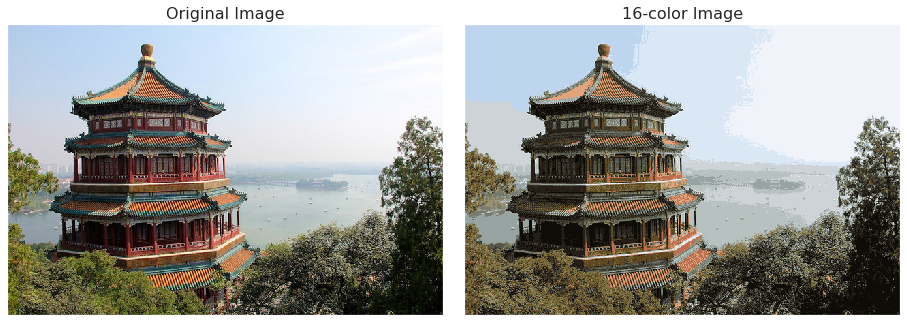

In [19]:
#@title #Clustering colors
from sklearn.datasets import load_sample_image
import matplotlib.pyplot as plt

china = load_sample_image("china.jpg")

data = china / 255.0 
data = data.reshape(427 * 640, 3)

import warnings; warnings.simplefilter('ignore')  # Fix NumPy issues.
from sklearn.cluster import MiniBatchKMeans
kmeans = MiniBatchKMeans(16)
kmeans.fit(data)
new_colors = kmeans.cluster_centers_[kmeans.predict(data)]

china_recolored = new_colors.reshape(china.shape)

fig, ax = plt.subplots(1, 2, figsize=(16, 6), subplot_kw=dict(xticks=[], yticks=[]))
fig.subplots_adjust(wspace=0.05)
ax[0].imshow(china)
ax[0].set_title('Original Image', size=16)
ax[1].imshow(china_recolored)
ax[1].set_title('16-color Image', size=16);

####### plotting only ######

import numpy as np
from plotly.subplots import make_subplots
import plotly.graph_objects as go

N = 10000
rng = np.random.RandomState(0)
i = rng.permutation(data.shape[0])[:N]
R, G, B = data[i].T
colors = ['rgba(' + ','.join([str(r*255), str(g*255), str(b*255)]) + ', 255)' for r,g,b in zip(R,G,B)]

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "scene"}, {"type": "scene"}]])

fig.add_trace(go.Scatter3d(x=R, y=G, z=B, mode='markers', 
                           marker=dict(size=4, color=colors)),
              row=1, col=1)

R, G, B = new_colors[i].T
colors = ['rgba(' + ','.join([str(r*255), str(g*255), str(b*255)]) + ', 255)' for r,g,b in zip(R,G,B)]

fig.add_trace(go.Scatter3d(x=R, y=G, z=B, mode='markers', 
                           marker=dict(size=4, color=colors)),
              row=1, col=2)

R, G, B = data[i].T

fig.add_trace(go.Scatter3d(x=R, y=G, z=B, mode='markers', 
                           marker=dict(size=4, color=colors)),
              row=1, col=2)

fig.update_layout(width=1200, height=600, autosize=False, 
                  title_text="Color scale demonstration",
                  scene={"xaxis": {"title": "R"},
                         "yaxis": {"title": "G"},
                         "zaxis": {"title": "B"}},
                  scene2={"xaxis": {"title": "R"},
                          "yaxis": {"title": "G"},
                          "zaxis": {"title": "B"}},
                  showlegend=False,
                  annotations=[{"x": 0.225, "y": 1, "font": {"size": 16},
                    "text": "Original color space",
                    "xref": "paper", "yref": "paper",
                    "xanchor": "center", "yanchor": "bottom",
                    "showarrow": False
                  }, {"x": 0.775, "y": 1, "font": {"size": 16},
                  "text": "Reduced color space",
                  "xref": "paper", "yref": "paper",
                  "xanchor": "center", "yanchor": "bottom",
                  "showarrow": False
                }],
                updatemenus = [{'type': 'buttons', 'buttons': [
                      {'label': 'All', 'method': 'update',
                       'args': [{'visible' : [True, False, True]}]},
                      {'label': 'Cluster centers', 'method': 'update',
                       'args': [{'visible' : [True, True, False]}]}
                ]}])
      
fig.show()

In [20]:
#@title #custom K-means
# a very basic implementation of k-means

from sklearn.metrics import pairwise_distances_argmin

def find_clusters(X, n_clusters, callback):
  # 1. Randomly choose clusters
  rng = np.random.RandomState()
  i = rng.permutation(X.shape[0])[:n_clusters]
  centers = X[i]
    
  while True:
    # 2a. Assign labels based on closest center
    labels = pairwise_distances_argmin(X, centers)

    # do callback
    callback(X, labels, centers)
    
    # 2b. Find new centers from means of points
    new_centers = np.array([X[labels == i].mean(0) for i in range(n_clusters)])
    
    # 2c. Check for convergence
    if np.all(centers == new_centers):
        break
    centers = new_centers


import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def plot_clusters(X, y, center):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  ax.set_xlim([-1, 1])
  ax.set_ylim([-1, 1])

  plt.scatter(X[:, 0], X[:, 1], c=y, s=150, cmap='viridis')
  # see https://matplotlib.org/3.1.1/api/markers_api.html
  plt.scatter(center[:, 0], center[:, 1], c=range(len(center)), marker='s', s=200, alpha=0.7);
    
  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json

video = []

def im_gen(X, y_kmeans, centers):
  global video
  fig = plot_clusters(X, y_kmeans, centers)
  image_base64 = figure_to_base64(fig)
  video.append(image_base64)

def invoke(pts, depth):
  data = np.array(pts).reshape((-1, 2))
  X = data / 300.0 - 1.0
  X[:, 1] *= -1.0

  #y_kmeans, centers = cluster(X)
  #fig = plot_clusters(X, y_kmeans, centers)
  global video
  video = []
  find_clusters(X, int(depth), im_gen) # change n_clusters later
  #image_base64 = figure_to_base64(fig)
  return IPython.display.JSON({'images': video})


import IPython
from google.colab import output

main_str = '''
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();
    var frames = [];
    var frame_index = 0;

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = 'rgba(50, 50, 50, 0.3)';
      ctx.fill();
    }
    
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText(debug_txt, 200, 200);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]]);
        });
        
        
        
      }
    }
    
    function advance()
    {
      if (frames.length <= 0)
        return;
      if (frame_index < frames.length - 1)
        frame_index += 1;
      bg_image.src = 'data:image/  png;base64,' + frames[frame_index];
    }

    var timer, timer_video;
    function init() {
      timer = setInterval(draw, 10);
      timer_video = setInterval(advance, 1000);
    }

    function get_state() {
      var rates = document.getElementsByName('rate');
      for(var i = 0; i < rates.length; i++)
        if(rates[i].checked)
          return rates[i].value;
      return "none";
    }

    
    function mdown_handle(evt) {
      x = evt.offsetX;
      y = evt.offsetY;
      state = get_state();
      if (state == "add") {
        if (x < 600)
            all_pts.push([x, y]);
        return;
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx <= -1)
          return;
      if (state == "move") {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
      if (state == "del")
          all_pts.splice(idx, 1);
    }
    
    function mmove_handle(evt) {
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    function clear_field() {
      active_pt = null;
      all_pts = [];
    }

    var cur_depth = 1;

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged, cur_depth], {});
      params = result.data['application/json'];
      frames = params.images;
      frame_index = 0;
      bg_image.src = 'data:image/  png;base64,' + params.images[0];
    }

   function h_change(x) {
    el = document.getElementById("slider_val");
    cur_depth = x;
    el.innerHTML = x;
  }

  </script>
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:275px; left:625px;">
   <div style="border-style: solid;">
    <input type="radio" id="r1" name="rate" value="add" checked="checked"> Add Feature
    <br>
    <input type="radio" id="r2" name="rate" value="move"> Move Features
    <br>
    <input type="radio" id="r3" name="rate" value="del"> Delete Feature
    <br>
    <button type="button" onclick="clear_field();">
      Clear
    </button>
   </div>
   <br><br>Number of clusters:<br>
    <input type="range" min="1" max="9" value="1" oninput="h_change(this.value)">
    <br><div id="slider_val">1</div>
   <br><br>
    <button type="button" onclick="calculate();">
      Cluster
    </button>
  </div>
  <script> init();</script>
'''



def generate_html():
  s = main_str
  return s
  
display(IPython.display.HTML(generate_html()))
    
    
output.register_callback('notebook.InvSVM', invoke)

#Lecture ??, "Gaussian Mixture Models"

In [21]:
#@title #Mixture Model of 3 Gaussians
from ipywidgets import HBox, VBox, FloatSlider, FloatRangeSlider
import ipywidgets as widgets
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats

words = ['mu_1', 'sigma_1', 'mu_2', 'sigma_2', 'mu_3', 'sigma_3']
mins  = [0.0, 1.0, 0.0, 1.0, 0.0, 1.0]
maxes = [100.0, 10.0, 100.0, 10.0, 100.0, 10.0]
vals  = [10.0, 10.0, 50.0, 10.0, 90.0, 10.0]
sliders = [FloatSlider(description=w, min=n, max=x, value=v) for w,x,n,v in zip(words, maxes, mins, vals)]
pi_slider = FloatRangeSlider(value=[0.3, 0.6], min=0.0, max=1.0, description='pi(1,2,3)')
boxes = [VBox([pi_slider])]
for slider1, slider2 in zip(sliders[::2], sliders[1::2]):
  boxes.append(VBox([slider1, slider2]))

def plot_pdf(pi, mu1, sig1, mu2, sig2, mu3, sig3):
  pi1, pi2 = pi; pi2 -= pi1; pi3 = 1.0 - pi2 - pi1;
  x = np.linspace(0, 100, 1001)
  fig = plt.figure(figsize=(10, 8))
  P_sum = np.zeros(x.shape)
  for mu, sig, c, pi, i in [[mu1, sig1, 'r', pi1, 1], [mu2, sig2, 'g', pi2, 2], [mu3, sig3, 'b', pi3, 3]]:
    P = scipy.stats.norm.pdf(x, mu, sig)
    P_sum += P * pi
    plt.plot(x, P, c, linewidth=2.0, label="{}".format(i), alpha=np.clip(pi, 0.0, 1.0))

  
  plt.plot(x, P_sum, 'k', linewidth=3.0)

  plt.title('Mixture of 3 Gaussians')
  plt.xlabel('x')
  plt.ylabel('y')
  plt.legend()
  plt.show()

out = widgets.interactive_output(plot_pdf, {
    "pi": pi_slider,
    "mu1": sliders[0], "sig1": sliders[1],
    "mu2": sliders[2], "sig2": sliders[3],
    "mu3": sliders[4], "sig3": sliders[5]})

display(HBox(boxes), out)

Output()

In [22]:
#@title #2D GMM
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

def cluster(X, n):
  gmm2 = GaussianMixture(n_components=n, covariance_type='full', random_state=0)
  gmm2.fit(X)
  y_kmeans = gmm2.predict(X)
  centers = gmm2.means_
  covs = gmm2.covariances_
  w = gmm2.weights_
  return y_kmeans, centers, covs, w

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Ellipse
from matplotlib import cm

def draw_ellipse(position, covariance, ax, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height, angle, **kwargs))
        
def plot_clusters(X, y, center, covariances, weights):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.tick_params(axis="y",direction="in", pad=-40)
  ax.tick_params(axis="x",direction="in", pad=-15)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  ax.set_xlim([-1, 1])
  ax.set_ylim([-1, 1])

  cmap = cm.get_cmap('viridis')
  c_norm = len(center)
  plt.scatter(X[:, 0], X[:, 1], c=y/c_norm, s=50)
  plt.scatter(center[:, 0], center[:, 1], c='red', marker='x', s=200, alpha=0.5);
  
  w_factor = 0.2 / weights.max()
  for pos, covar, w, c in zip(center, covariances, weights, range(c_norm)):
    clr = 0.5 if c_norm <= 1 else c/(c_norm-1)
    draw_ellipse(pos, covar, ax, alpha=w * w_factor, fc=cmap(clr))

  plt.close(fig)

  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64


def get_surface_data(centers, covs, w):
  x_ = np.linspace(-1.0, +1.0, num=300)
  y_ = np.linspace(-1.0, +1.0, num=300)
  xx, yy = np.meshgrid(x_, y_)
  x_vec = np.transpose(np.vstack([xx.ravel(), yy.ravel()])) - centers[:, np.newaxis]
  prod_1 = np.array([np.dot(v,m) for v,m in zip(x_vec, np.linalg.inv(covs))])
  prod_2 = np.array([np.sum(v1*v2, axis=1) for v1,v2 in zip(prod_1, x_vec)])
  g = np.exp(-0.5 * prod_2) / np.sqrt(np.linalg.det(covs).shape) / 2.0 / np.pi
  g = g.reshape((g.shape[0], x_.shape[0], y_.shape[0]))
  G = np.sum(g*w[:,np.newaxis, np.newaxis], axis=0)
  C = np.argmax(g, axis=0)
  return x_, y_, G, C

import json
from IPython.display import display, clear_output

def invoke(pts, n):
  global html_div

  data = np.array(pts).reshape((-1, 2))
  X = data / 300.0 - 1.0
  X[:, 1] *= -1.0

  y_kmeans, centers, covs, w = cluster(X, int(n))
  figr = plot_clusters(X, y_kmeans, centers, covs, w)
  image_base64 = figure_to_base64(figr)

  x_, y_, G, C = get_surface_data(centers, covs, w)

  return IPython.display.JSON({'image': image_base64, 
                               'g_x': x_.tolist(), 'g_y': y_.tolist(), 'g_z': G.tolist(), 'g_c': C.tolist(),
                               's_x': X[:, 0].tolist(), 's_y': X[:, 1].tolist(), 's_z': [0]*len(X), 's_c': y_kmeans.tolist()})


import IPython
from google.colab import output

main_str = '''
  <script src="https://cdn.plot.ly/plotly-latest.min.js"></script> 
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = 'rgba(50, 50, 50, 0.2)';
      ctx.fill();
    }
    
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText(debug_txt, 200, 200);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]]);
        });

      }
    }
    
    var timer

    function get_state() {
      var rates = document.getElementsByName('rate');
      for(var i = 0; i < rates.length; i++)
        if(rates[i].checked)
          return rates[i].value;
      return "none";
    }

    
    function mdown_handle(evt) {
      evt.stopPropagation();
      x = evt.offsetX;
      y = evt.offsetY;
      state = get_state();
      if (state == "add") {
        if (x < 600)
            all_pts.push([x, y]);
        return;
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx <= -1)
          return;
      if (state == "move") {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
      if (state == "del")
          all_pts.splice(idx, 1);
    }
    
    function mmove_handle(evt) {
      evt.stopPropagation();
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      evt.stopPropagation();
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    function clear_field() {
      active_pt = null;
      all_pts = [];
    }


   function plot_3d(g_x, g_y, g_z, g_c)
   {
     cell_for_plot = document.getElementById('for_plotly_plot');
     //Plotly.deleteTraces(cell_for_plot, [0, 1]);
     var data = [{
           x: g_x,
           y: g_y,
           z: g_z,
           type: 'surface',
           surfacecolor: g_c,
           opacity: 0.9,
           showscale: false,
           colorscale: "Viridis"
        }];
  
     var layout = {
          title: '3D Gaussian profile',
          autosize: false,
          width: 600,
          height: 600,
          showlegend: false,
          scene: {
            camera: {
              up: {x: 0, y: 1, z: 0},
              center: {x: 0, y: 0, z: 0},
              eye: {x: 0.0, y: -1.0, z: 1.4}
            }
          }
        };
     Plotly.newPlot(cell_for_plot, data, layout);
   }

   function plot_scatter(s_x, s_y, s_z, s_c)
   {
          
     cell_for_plot = document.getElementById('for_plotly_plot');
     var data = [{
           x: s_x,
           y: s_y,
           z: s_z,
           type: 'scatter3d',
           mode: 'markers',
           marker: {
             size: 4,
             colorscale: "Viridis",
             color: s_c,
             line: {
               width: 2,
               color: 'rgba(0, 0, 0, 0.5)'
             }
           }
        }];
    Plotly.plot(cell_for_plot, data, {});
   }


    var cur_depth = 1;

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged, cur_depth], {});
      params = result.data['application/json'];
            
      bg_image.src = 'data:image/  png;base64,' + params.image;
      cell_for_plot = document.getElementById('for_plotly_plot');
      
      plot_3d(params.g_x, params.g_y, params.g_z, params.g_c);
      plot_scatter(params.s_x, params.s_y, params.s_z, params.s_c);
      
    }

   function h_change(x) {
    el = document.getElementById("slider_val");
    cur_depth = x;
    el.innerHTML = x;
  }

 </script>

<div id="everything" style="height:600px;">
<div id="for_plotly_plot" style="position:absolute; top:0px; left:0px; height:600px; width:600px;">
</div>
<div id="custom_controls" style="position:absolute; top:0px; left:600px;">
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:275px; left:625px;">
   <div style="border-style: solid;">
    <input type="radio" id="r1" name="rate" value="add" checked="checked"> Add Feature
    <br>
    <input type="radio" id="r2" name="rate" value="move"> Move Features
    <br>
    <input type="radio" id="r3" name="rate" value="del"> Delete Feature
    <br>
    <button type="button" onclick="clear_field();">
      Clear
    </button>
   </div>
   <br><br>Number of clusters:<br>
    <input type="range" min="1" max="9" value="1" oninput="h_change(this.value)">
    <br><div id="slider_val">1</div>
   <br><br>
    <button type="button" onclick="calculate();">
      GMM
    </button>
  </div>
</div>
<div>
  
<script>
function init()
{
  timer = setInterval(draw, 10);
}

init();
</script>
'''

display(IPython.display.HTML(main_str))
output.register_callback('notebook.InvSVM', invoke)

#Lecture ??, "Kernel Density Estimation"

In [23]:
#@title Varying bin size

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from scipy.optimize import minimize


Nbins = 10
x_min, x_max = 4.0, 10.0
y_min, y_max = 0.0, 1.0
x_ = np.array([93.5,93,60.8,94.5,82,87.5,91.5,99.5,86,93.5,92.5,78,76,69,94.5,89.5,92.8,78,65.5,98,98.5,92.3,95.5,76,91,95,61.4,96,90]) * 0.1 - 1.0
y_ = np.array([0.0] * x_.shape[0])


fig = dict(
    layout = dict(
        width=600, height=600, autosize=False,
        showlegend = False,
        xaxis1 = {'domain': [0.0, 1.0], 'range': [x_min, x_max]},
        yaxis1 = {'domain': [0.0, 1.0], 'range': [y_min, y_max]},
        title  = 'Binning',
        margin = {'t': 50, 'b': 50, 'l': 50, 'r': 50},
        updatemenus = [{'buttons': [{'args': [[k for k in range(Nbins)],
                                              {'frame': {'duration': 500.0, 'redraw': True},
                                               'fromcurrent': False, 'transition': {'duration': 0, 'easing': 'linear'}}],
                                     'label': 'Play',
                                     'method': 'animate'},
                                    {'args': [[None], {'frame': {'duration': 0, 'redraw': True},
                                                       'mode': 'immediate',
                                                       'transition': {'duration': 0}}
                                              ],
                                     'label': 'Pause',
                                     'method': 'animate'
                                     }
                                    ],
                        'direction': 'left',
                        'pad': {'r': 10, 't': 85},
                        'showactive': True,
                        'type': 'buttons', 'x': 0.1, 'y': 0, 'xanchor': 'right', 'yanchor': 'top'}],
        sliders = [{'yanchor': 'top',
                    'xanchor': 'left',
                    'currentvalue': {'font': {'size': 16}, 'prefix': 'Bins: ', 'visible': True, 'xanchor': 'right'},
                    'transition': {'duration': 0.0},
                    'pad': {'b': 10, 't': 50},
                    'len': 0.9,
                    'x': 0.1,
                    'y': 0,
                    'steps': [{'args': [[k], {'frame': {'duration': 500.0, 'easing': 'linear', 'redraw': True},
                                              'transition': {'duration': 0, 'easing': 'linear'}}
                                        ],
                               'label': k+1,
                               'method': 'animate'} for k in range(Nbins)
                    ]}]
    ),
    data = [
        {'type': 'histogram', 'name': 'f2', 'x': x_, 'opacity': 0.8, 
         'xbins': {'start': x_min, 'end': x_max, 'size': (x_max - x_min)},
         'histnorm': 'probability'},
        {'type': 'scatter', 'name': 's2', 'x': x_, 'y': y_, 'mode': 'markers' }
    ],
    frames=[
        {'name': str(k),
         'data': [
           {'type': 'histogram', 'name': 'f2', 'x': x_, 
            'xbins': {'start': x_min, 'end': x_max, 'size': (x_max - x_min)/(k+1)}, 'autobinx': False, 
            'histnorm': 'probability', 'opacity': 0.8},
           {'type': 'scatter', 'name': 's2', 'x': x_, 'y': y_, 'mode': 'markers' }
         ]} for k in range(Nbins) ]
)
#plot(fig, auto_open=False)
f = go.Figure(fig)
f.show()

In [24]:
#@title Moving points


from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
from scipy.optimize import minimize


Nbins = 10
x_min, x_max = 4.0, 10.0
y_min, y_max = 0.0, 1.0
x_ = np.array([93.5,93,60.8,94.5,82,87.5,91.5,99.5,86,93.5,92.5,78,76,69,94.5,89.5,92.8,78,65.5,98,98.5,92.3,95.5,76,91,95,61.4,96,90]) * 0.1 - 1.0
y_ = np.array([0.0] * x_.shape[0])

fig = dict(
    layout = dict(
        width=600, height=600, autosize=False,
        showlegend = False,
        xaxis1 = {'domain': [0.0, 1.0], 'range': [x_min, x_max]},
        yaxis1 = {'domain': [0.0, 1.0], 'range': [y_min, y_max]},
        title  = 'Binning',
        margin = {'t': 50, 'b': 50, 'l': 50, 'r': 50},
        updatemenus = [{'buttons': [{'args': [[k for k in range(Nbins)],
                                              {'frame': {'duration': 500.0, 'redraw': True},
                                               'fromcurrent': False, 'transition': {'duration': 0, 'easing': 'linear'}}],
                                     'label': 'Play',
                                     'method': 'animate'},
                                    {'args': [[None], {'frame': {'duration': 0, 'redraw': True},
                                                       'mode': 'immediate',
                                                       'transition': {'duration': 0}}
                                              ],
                                     'label': 'Pause',
                                     'method': 'animate'
                                     }
                                    ],
                        'direction': 'left',
                        'pad': {'r': 10, 't': 85},
                        'showactive': True,
                        'type': 'buttons', 'x': 0.1, 'y': 0, 'xanchor': 'right', 'yanchor': 'top'}],
        sliders = [{'yanchor': 'top',
                    'xanchor': 'left',
                    'currentvalue': {'font': {'size': 16}, 'prefix': 'Shift x 10: ', 'visible': True, 'xanchor': 'right'},
                    'transition': {'duration': 0.0},
                    'pad': {'b': 10, 't': 50},
                    'len': 0.9,
                    'x': 0.1,
                    'y': 0,
                    'steps': [{'args': [[k], {'frame': {'duration': 500.0, 'easing': 'linear', 'redraw': True},
                                              'transition': {'duration': 0, 'easing': 'linear'}}
                                        ],
                               'label': k+1,
                               'method': 'animate'} for k in range(Nbins)
                    ]}]
    ),
    data = [
        {'type': 'histogram', 'name': 'f2', 'x': x_, 'opacity': 0.8, 
         'xbins': {'start':x_min, 'end': x_max, 'size': 0.5}, 'autobinx': False,
         'histnorm': 'probability'},
        {'type': 'scatter', 'name': 's2', 'x': x_, 'y': y_, 'mode': 'markers' }
    ],
    frames=[
        {'name': str(k),
         'data': [
           {'type': 'histogram', 'name': 'f2', 'x': x_ + k * 0.1, 
            'xbins': {'start':x_min, 'end': x_max, 'size': 0.5}, 'autobinx': False, 
            'histnorm': 'probability', 'opacity': 0.8},
           {'type': 'scatter', 'name': 's2', 'x': x_ + k * 0.1, 'y': y_, 'mode': 'markers' }
         ]} for k in range(Nbins) ]
)
#plot(fig, auto_open=False)
f = go.Figure(fig)
f.show()

In [25]:
# install KDEpy library before starting the following demo
!pip install KDEpy

     |████████████████████████████████| 389kB 2.8MB/s 


In [26]:
#@title Bandwidth and kernel in KDE
from google.colab import widgets
import ipywidgets
import numpy as np
import matplotlib.pyplot as plt
import scipy
from sklearn.neighbors import KernelDensity
from sklearn.model_selection import learning_curve, GridSearchCV
from sklearn.model_selection import LeaveOneOut #train_test_split
from KDEpy import FFTKDE


params = []
X = []
b_w = ipywidgets.FloatSlider(description='bandwidth', min=1, max=50.0, value=15.0)
ker_type = ipywidgets.Dropdown(
  options=['gaussian', 'tophat', 'epanechnikov', 'exponential','linear','cosine'],
  value='gaussian',
  description='Kernel:',
  disabled=False)

def set_slider(x):
  bandwidths = np.linspace(b_w.min, b_w.max, 100)
  loo = LeaveOneOut()
  grid = GridSearchCV(KernelDensity(kernel=ker_type.value), {'bandwidth': bandwidths}, cv=loo)
  grid.fit(np.array(X)[:, None]);
  b_w.value = grid.best_params_['bandwidth']

def set_slider2(x):
  ker = {'gaussian':'gaussian', 'cosine':'cosine', 
         'tophat':'box', 'epanechnikov':'epa', 
         'exponential':'exponential', 'linear':'tri'}
  kde = FFTKDE(bw='ISJ', kernel=ker[ker_type.value])
  kde.fit(X)(None)
  b_w.value = kde.bw

def set_slider1(x):
  #std = np.sqrt(np.var(X, axis=0))
  #silverman = ((4/(3* len(np.array(X)[:, None])))*std**5)**(1/5)
  #b_w.value = silverman

  ker = {'gaussian':'gaussian', 'cosine':'cosine', 
         'tophat':'box', 'epanechnikov':'epa', 
         'exponential':'exponential', 'linear':'tri'}
  kde = FFTKDE(bw='silverman', kernel=ker[ker_type.value])
  kde.fit(X)(None)
  b_w.value = kde.bw

def plot_pdf(plot_separate, k_d = None):
  global params
  global X
  if not params:
    return

  pi1, pi2, pi3, mu1, sig1, mu2, sig2, mu3, sig3 = params
  x = np.linspace(np.min(X), np.max(X), 1001)
  fig = plt.figure(figsize=(10, 8))
  P_sum = np.zeros(x.shape)
  for mu, sig, c, pi, i in [[mu1, sig1, 'r', pi1, 1], [mu2, sig2, 'g', pi2, 2], [mu3, sig3, 'b', pi3, 3]]:
    P = scipy.stats.norm.pdf(x, mu, sig)
    P_sum += P * pi
    if plot_separate:
      plt.plot(x, P, c, linewidth=2.0, label="{}".format(i), alpha=np.clip(pi, 0.0, 1.0))
  
  plt.plot(x, P_sum, 'k', linewidth=3.0, label="mixture")
  plt.plot(np.array(X), np.full_like(np.array(X), 0.0), '|k', markeredgewidth=1)
  plt.title('True pdf / pdf estimate')
  plt.xlabel('x')
  plt.ylabel('pdf')
  plt.legend()
  #plt.show()

def set_and_plot(pi, mu1, sig1, mu2, sig2, mu3, sig3):
  pi1, pi2 = pi; pi2 -= pi1; pi3 = 1.0 - pi2 - pi1;
  global params
  global X
  X = []
  params = [pi1, pi2, pi3, mu1, sig1, mu2, sig2, mu3, sig3]
  N = 200
  for mu, sig, pi in [[mu1, sig1, pi1], [mu2, sig2, pi2], [mu3, sig3, pi3]]:
    X = X + np.random.normal(mu, sig, int(N * pi)).tolist()
  plot_pdf(True)


def ker_plot(b_w, k_t):
  kde = KernelDensity(bandwidth=b_w, kernel=k_t)
  global X
  kde.fit(np.array(X)[:, None])
  x_d = np.linspace(np.min(X), np.max(X), 1001)
  logprob = kde.score_samples(x_d[:, None])
  plot_pdf(False)
  plt.fill_between(x_d, np.exp(logprob), alpha=0.5, color='r')

tb = widgets.TabBar(['mix distribution', 'find KDE'], location='top')
with tb.output_to(0):
  words = ['mu_1', 'sigma_1', 'mu_2', 'sigma_2', 'mu_3', 'sigma_3']
  mins  = [0.0, 1.0, 0.0, 1.0, 0.0, 1.0]
  maxes = [100.0, 10.0, 100.0, 10.0, 100.0, 10.0]
  vals  = [10.0, 10.0, 50.0, 10.0, 90.0, 10.0]
  sliders = [ipywidgets.FloatSlider(description=w, min=n, max=x, value=v) for w,x,n,v in zip(words, maxes, mins, vals)]
  pi_slider = ipywidgets.FloatRangeSlider(value=[0.3, 0.6], min=0.0, max=1.0, description='pi(1,2,3)')
  boxes = [ipywidgets.VBox([pi_slider])]
  for slider1, slider2 in zip(sliders[::2], sliders[1::2]):
    boxes.append(ipywidgets.VBox([slider1, slider2]))
  out = ipywidgets.interactive_output(set_and_plot, {
    "pi": pi_slider,
    "mu1": sliders[0], "sig1": sliders[1],
    "mu2": sliders[2], "sig2": sliders[3],
    "mu3": sliders[4], "sig3": sliders[5]})
  display(ipywidgets.HBox(boxes), out)
with tb.output_to(1):
  btn = ipywidgets.Button(
    description='Cross Validation',
    disabled=False,
    button_style='')
  btn1 = ipywidgets.Button(
    description='Silverman',
    disabled=False,
    button_style='')
  btn2 = ipywidgets.Button(
    description='ISJ',
    disabled=False,
    button_style='')
  out = ipywidgets.interactive_output(ker_plot, {"b_w": b_w, "k_t": ker_type})
  display(ipywidgets.HBox([ker_type, ipywidgets.VBox([b_w, ipywidgets.HBox([btn1, btn2, btn])])]), out)
  btn.on_click(set_slider)
  btn1.on_click(set_slider1)
  btn2.on_click(set_slider2)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Output()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Output()

<IPython.core.display.Javascript object>

In [28]:
#@title 2D KDE
from sklearn.neighbors import KernelDensity
# instantiate and fit the KDE model
kde = KernelDensity()

def fit_distribution(X, bandwidth, ker_name, metric_name):
  params = {'bandwidth': bandwidth, 'kernel': ker_name, 'metric': metric_name}
  kde.set_params(**params)
  kde.fit(X)

def evaluate_distribution(X):
  logprob = kde.score_samples(X)
  return np.exp(logprob)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import cm
import seaborn as sns
        
def plot_clusters(x_, y_, z_):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  #ax = sns.kdeplot(X[:,0], X[:,1], cmap="Blues", shade=True, shade_lowest=False)
  sns.set()
  ax.contourf(x_, y_, z_, alpha=0.5, cmap="Blues")
  ax.tick_params(axis="y",direction="in", pad=-60)
  ax.tick_params(axis="x",direction="in", pad=-30)
  ax.set_xticks(np.arange(-.75, 1, .25))
  ax.set_yticks(np.arange(-.75, 1, .25))
  ax.set_xlim([-1, 1])
  ax.set_ylim([-1, 1])

  plt.close(fig)
  return fig

import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64



import json
from IPython.display import display, clear_output

def invoke(pts, n, ker_name, metric_name):
  data = np.array(pts).reshape((-1, 2))
  X = data / 300.0 - 1.0
  X[:, 1] *= -1.0
  fit_distribution(X, float(n)/1000.0, ker_name, metric_name)
  x_ = np.linspace(-1.0, +1.0, num=300)
  y_ = np.linspace(-1.0, +1.0, num=300)
  xx, yy = np.meshgrid(x_, y_)
  x_vec = np.transpose(np.vstack([xx.ravel(), yy.ravel()]))
  G  = evaluate_distribution(x_vec).reshape((x_.shape[0],y_.shape[0]))
  figr = plot_clusters(x_, y_, G)
  image_base64 = figure_to_base64(figr)

  return IPython.display.JSON({'image': image_base64, 
                               'g_x': x_.tolist(), 'g_y': y_.tolist(), 'g_z': G.tolist(),
                               's_x': X[:, 0].tolist(), 's_y': X[:, 1].tolist(), 's_z': [0]*len(X)})


import IPython
from google.colab import output

main_str = '''
  <script src="https://cdn.plot.ly/plotly-latest.min.js"></script> 
  <script type="application/javascript">
  
    var active_pt = null;
    var all_pts = [];
    var classAbtn = [650, 100];
    var classBbtn = [650, 200];
    var ptR = 10.0;
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    function is_close(pt1, pt2) {
      return   (pt1[0] - pt2[0])*(pt1[0] - pt2[0])
            +  (pt1[1] - pt2[1])*(pt1[1] - pt2[1])
            <= ptR*ptR;
    }
  
    function circ(ctx, pos) {
      ctx.beginPath();
      ctx.arc(pos[0], pos[1], ptR, 0.0, 2.0 * Math.PI, 0);
      ctx.fillStyle = 'rgba(255, 128, 0, 0.5)';
      ctx.fill();
    }
    
    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText(debug_txt, 200, 200);
        
        if (active_pt) {
          circ(ctx, [active_pt[0], active_pt[1]]);
        }
        all_pts.forEach(function (item, index) {
          circ(ctx, [item[0], item[1]]);
        });

      }
    }
    
    var timer

    function get_state() {
      var rates = document.getElementsByName('rate');
      for(var i = 0; i < rates.length; i++)
        if(rates[i].checked)
          return rates[i].value;
      return "none";
    }

    
    function mdown_handle(evt) {
      evt.stopPropagation();
      x = evt.offsetX;
      y = evt.offsetY;
      state = get_state();
      if (state == "add") {
        if (x < 600)
            all_pts.push([x, y]);
        return;
      }

      idx = -1;
      all_pts.forEach(function (item, index) {
        if (is_close([x,y], [item[0], item[1]])) {
          idx = index;
        }
      });
      if (idx <= -1)
          return;
      if (state == "move") {
        active_pt = all_pts[idx];
        all_pts.splice(idx, 1);
      }
      if (state == "del")
          all_pts.splice(idx, 1);
    }
    
    function mmove_handle(evt) {
      evt.stopPropagation();
      if (get_state() != "move")
          return;
      x = evt.offsetX;
      y = evt.offsetY;
      if (active_pt) {
        active_pt[0] = x;
        active_pt[1] = y;
      }
    }
    
    function mup_handle(evt) {
      evt.stopPropagation();
      x = evt.offsetX;
      y = evt.offsetY;
      if (x >= 600) {
        active_pt = null;
      }
      if (active_pt) {
        all_pts.push(active_pt);
        active_pt = null;
      }
    }
    
    function clear_field() {
      active_pt = null;
      all_pts = [];
    }


   function plot_3d(g_x, g_y, g_z)
   {
     cell_for_plot = document.getElementById('for_plotly_plot');
     //Plotly.deleteTraces(cell_for_plot, [0, 1]);
     var data = [{
           x: g_x,
           y: g_y,
           z: g_z,
           type: 'surface',
           opacity: 0.9,
           showscale: false,
           colorscale: "Viridis"
        }];
  
     var layout = {
          title: 'pdf estimate',
          autosize: false,
          width: 600,
          height: 600,
          showlegend: false,
          scene: {
            camera: {
              up: {x: 0, y: 1, z: 0},
              center: {x: 0, y: 0, z: 0},
              eye: {x: 0.0, y: -1.0, z: 1.4}
            }
          }
        };
     Plotly.newPlot(cell_for_plot, data, layout);
   }

   function plot_scatter(s_x, s_y, s_z)
   {
          
     cell_for_plot = document.getElementById('for_plotly_plot');
     var data = [{
           x: s_x,
           y: s_y,
           z: s_z,
           type: 'scatter3d',
           mode: 'markers',
           marker: {
             size: 4,
             colorscale: "Viridis",
             line: {
               width: 2,
               color: 'rgba(0, 0, 0, 0.5)'
             }
           }
        }];
    Plotly.plot(cell_for_plot, data, {});
   }


    var cur_depth = 100;

    async function calculate() {
      if (!all_pts)
        return;
      var merged = [].concat.apply([], all_pts);
      var e = document.getElementById("select_kernel");
      var ker_name = e.options[e.selectedIndex].value;
      var e1 = document.getElementById("select_metric");
      var metric_name = e1.options[e1.selectedIndex].value;
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [merged, cur_depth, ker_name, metric_name], {});
      params = result.data['application/json'];
            
      bg_image.src = 'data:image/  png;base64,' + params.image;
      cell_for_plot = document.getElementById('for_plotly_plot');
      
      plot_3d(params.g_x, params.g_y, params.g_z);
      plot_scatter(params.s_x, params.s_y, params.s_z);
      
    }

   function h_change(x) {
    el = document.getElementById("slider_val");
    cur_depth = x;
    el.innerHTML = x;
  }

 </script>

<div id="everything" style="height:600px;">
<div id="for_plotly_plot" style="position:absolute; top:0px; left:0px; height:600px; width:600px;">
</div>
<div id="custom_controls" style="position:absolute; top:0px; left:600px;">
  <canvas id="canvas" width="800" height="600" 
    onmousedown="mdown_handle(event)"
    onmousemove="mmove_handle(event)"
    onmouseup="mup_handle(event)"></canvas>
  <div style="position:absolute; top:200px; left:625px;">
   <div style="border-style: solid;">
    <input type="radio" id="r1" name="rate" value="add" checked="checked"> Add Feature
    <br>
    <input type="radio" id="r2" name="rate" value="move"> Move Features
    <br>
    <input type="radio" id="r3" name="rate" value="del"> Delete Feature
    <br>
    <button type="button" onclick="clear_field();">
      Clear
    </button>
   </div>
   <br><br>Bandwidth x 1000:<br>
    <input type="range" min="1" max="200" value="100" oninput="h_change(this.value)">
    <br><div id="slider_val">100</div>
   <br>Kernel:<br>
   <select id="select_kernel">
       <option value="gaussian">gaussian</option>
       <option value="tophat">tophat</option>
       <option value="epanechnikov">epanechnikov</option>
       <option value="exponential">exponential</option>
       <option value="linear">linear</option>
       <option value="cosine">cosine</option>
   </select>
   <br>
   Metric:
   <br>
   <select id="select_metric">
       <option value="euclidean">euclidean</option>
       <option value="manhattan">manhattan</option>
       <option value="infinity">infinity</option>
   </select>
   <br><br>
    <button type="button" onclick="calculate();">
      KDE
    </button>
  </div>
</div>
<div>
  
<script>
function init()
{
  timer = setInterval(draw, 10);
}

init();
</script>
'''

display(IPython.display.HTML(main_str))
output.register_callback('notebook.InvSVM', invoke)

In [29]:
# download the dataset
!wget https://raw.githubusercontent.com/fbeilstein/machine_learning/master/datasets/pumps.csv
!wget https://raw.githubusercontent.com/fbeilstein/machine_learning/master/datasets/deaths.csv
!wget https://raw.githubusercontent.com/fbeilstein/machine_learning/master/datasets/cholera_map.jpg

--2019-12-18 23:48:53--  https://raw.githubusercontent.com/fbeilstein/machine_learning/master/datasets/pumps.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 118 [text/plain]
Saving to: ‘pumps.csv’

pumps.csv           100%[===================>]     118  --.-KB/s    in 0s      

2019-12-18 23:48:53 (25.7 MB/s) - ‘pumps.csv’ saved [118/118]

--2019-12-18 23:48:54--  https://raw.githubusercontent.com/fbeilstein/machine_learning/master/datasets/deaths.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4811 (4.7K) [text/plain]
Saving to: ‘d

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

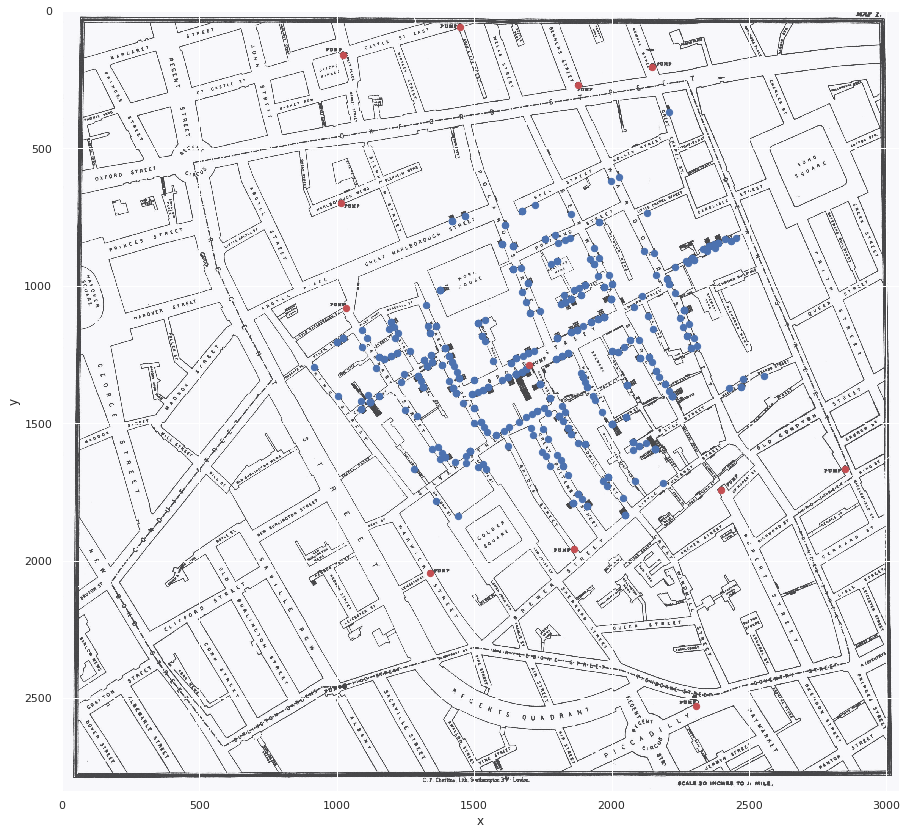

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

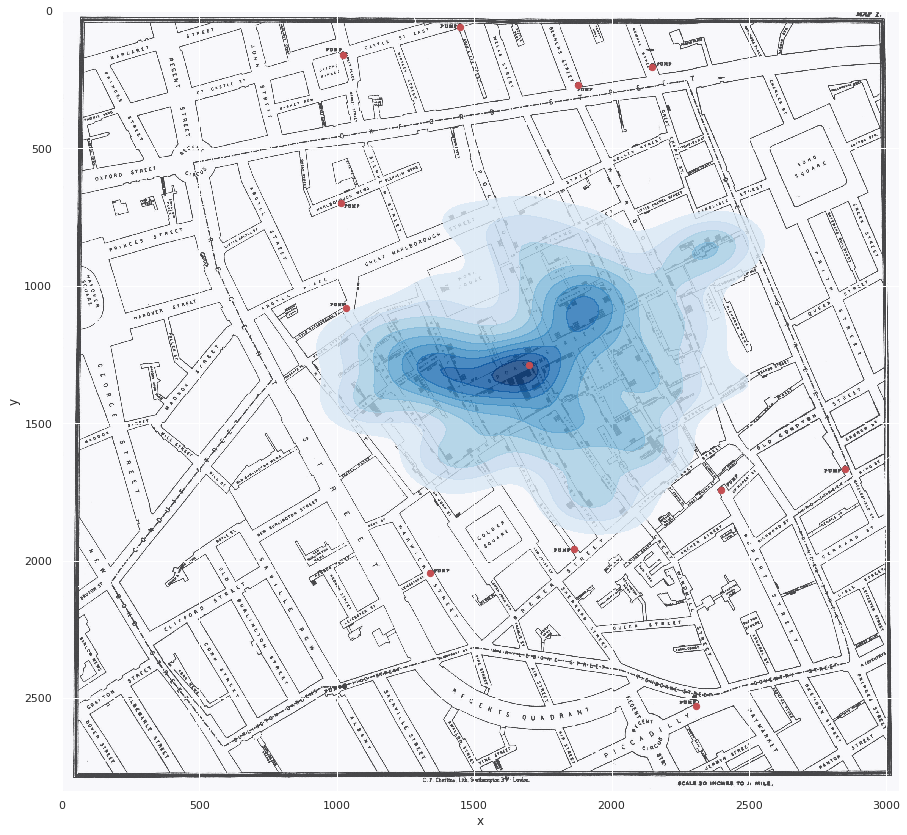

<IPython.core.display.Javascript object>

In [31]:
#@title #Cholera map
import pandas as pd

def read_dataframe(filename):
  return pd.read_csv(filename)

import matplotlib.pyplot as plt

def plot_map(filename):
  cholera_map = plt.imread(filename)
  plt.imshow(cholera_map, alpha=0.7);

def plot_points(dataframe, color):
  plt.scatter(x=dataframe['x'], y=dataframe['y'], c=color, s=40);

import seaborn as sns

def plot_kde(dataframe):
  sns.kdeplot(dataframe['x'], dataframe['y'], cmap="Blues", shade=True, shade_lowest=False, alpha=0.8);

from google.colab import widgets

tb = widgets.TabBar(['Scatter', 'KDE'], location='top')
with tb.output_to(0):
  plt.figure(figsize=(15, 15));
  plot_map('cholera_map.jpg')
  plot_points(read_dataframe('deaths.csv'), 'b')
  plot_points(read_dataframe('pumps.csv'), 'r')
  plt.ylabel('y')
  plt.xlabel('x')
with tb.output_to(1):
  plt.figure(figsize=(15, 15));
  plot_map('cholera_map.jpg')
  plot_kde(read_dataframe('deaths.csv'))
  plot_points(read_dataframe('pumps.csv'), 'r')
  plt.ylabel('y')
  plt.xlabel('x')

#Lecture ??, "Manifold Learning"

In [33]:
#@title #S-shaped manifold
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np

def make_hello(N=1000, rseed=42):
  # Make a plot with "HELLO" text; save as PNG
  fig, ax = plt.subplots(figsize=(4, 1))
  fig.subplots_adjust(left=0, right=1, bottom=0, top=1)
  ax.axis('off')
  ax.text(0.5, 0.4, 'HELLO', va='center', ha='center', weight='bold', size=85)
  fig.savefig('hello.png')
  plt.close(fig)
  # Open this PNG and draw random points from it
  from matplotlib.image import imread
  data = imread('hello.png')[::-1, :, 0].T
  rng = np.random.RandomState(rseed)
  X = rng.rand(4 * N, 2)
  i, j = (X * data.shape).astype(int).T
  mask = (data[i, j] < 1)
  X = X[mask]
  X[:, 0] *= (data.shape[0] / data.shape[1])
  X = X[:N]
  return X[np.argsort(X[:, 0])]

X = make_hello(1000)
colorize = dict(c=X[:, 0], cmap=plt.cm.get_cmap('rainbow', 5))

import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np

# arrange "hello" in non-linear, S-shaped way
def make_hello_s_curve(X):
  t = (X[:, 0] - 2) * 0.75 * np.pi
  x = np.sin(t)
  y = X[:, 1]
  z = np.sign(t) * (np.cos(t) - 1)
  return np.vstack((x, y, z)).T
XS = make_hello_s_curve(X)

import plotly.graph_objects as go
colors = ['rgb(' + np.array2string(c[:-1], formatter={'float_kind':lambda x:  "%.0f" % (x * 255)}, separator=',')[1:-1] + ')' for c in colorize['cmap'](0.255*colorize['c'])]
fig = go.Figure(data=[go.Scatter3d(x=XS[:, 0], y=XS[:, 1], z=XS[:, 2], mode='markers',  marker=dict(
        size=5,
        opacity=0.8,
        color=colors
    ))])
fig.show()


In [34]:
#@title Pairwise distances MDS vs LLE
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np

def make_hello(N=1000, rseed=42):
  # Make a plot with "HELLO" text; save as PNG
  fig, ax = plt.subplots(figsize=(4, 1))
  fig.subplots_adjust(left=0, right=1, bottom=0, top=1)
  ax.axis('off')
  ax.text(0.5, 0.4, 'HELLO', va='center', ha='center', weight='bold', size=85)
  fig.savefig('hello.png')
  plt.close(fig)
  # Open this PNG and draw random points from it
  from matplotlib.image import imread
  data = imread('hello.png')[::-1, :, 0].T
  rng = np.random.RandomState(rseed)
  X = rng.rand(4 * N, 2)
  i, j = (X * data.shape).astype(int).T
  mask = (data[i, j] < 1)
  X = X[mask]
  X[:, 0] *= (data.shape[0] / data.shape[1])
  X = X[:N]
  return X[np.argsort(X[:, 0])]

X = make_hello(1000)
colorize = dict(c=X[:, 0], cmap=plt.cm.get_cmap('rainbow', 5))

import numpy as np

# arrange "hello" in non-linear, S-shaped way
def make_hello_s_curve(X):
  t = (X[:, 0] - 2) * 0.75 * np.pi
  x = np.sin(t)
  y = X[:, 1]
  z = np.sign(t) * (np.cos(t) - 1)
  return np.vstack((x, y, z)).T
XS = make_hello_s_curve(X)

from plotly.subplots import make_subplots
import plotly.graph_objects as go
colors = ['rgb(' + np.array2string(c[:-1], formatter={'float_kind':lambda x:  "%.0f" % (x * 255)}, separator=',')[1:-1] + ')' for c in colorize['cmap'](0.255*colorize['c'])]

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "scene"}, {"type": "scene"}]])

fig.add_trace(go.Scatter3d(x=XS[:, 0], y=XS[:, 1], z=XS[:, 2], 
                           mode='markers', name='datapoints (LEFT)', 
                           marker=dict(
                              size=5,
                              opacity=0.8,
                              color=colors
                            )
                           ), row=1, col=1)
fig.add_trace(go.Scatter3d(x=XS[:, 0], y=XS[:, 1], z=XS[:, 2], 
                           mode='markers', name='datapoints (RIGHT)', 
                           marker=dict(
                              size=5,
                              opacity=0.8,
                              color=colors
                            )
                           ), row=1, col=2)

# construct lines for LLE
from sklearn.neighbors import NearestNeighbors

rng = np.random.RandomState(42)
ind = rng.permutation(len(X))
nbrs = NearestNeighbors(n_neighbors=100).fit(XS).kneighbors(XS[ind[:100]])[1]
lines_LLE = []
for i in range(100):
  for j in nbrs[i]:
    lines_LLE = lines_LLE + [XS[ind[i]], XS[j], np.array([None, None, None])]
lines_LLE = np.array(lines_LLE)

fig.add_trace(go.Scatter3d(
    x=lines_LLE[:, 0],
    y=lines_LLE[:, 1],
    z=lines_LLE[:, 2],
    mode='lines', opacity=0.2,
    line={'color': 'rgb(0,0,0)', 'width': 1},
    name='LLE connections'
), row=1, col=1)

# construct lines for MDS
lines_MDS = []
for i in ind[:100]:
  for j in ind[100:200]:
    lines_MDS = lines_MDS + [XS[i], XS[j], np.array([None, None, None])]
lines_MDS = np.array(lines_MDS)

fig.add_trace(go.Scatter3d(
    x=lines_MDS[:, 0],
    y=lines_MDS[:, 1],
    z=lines_MDS[:, 2],
    mode='lines', opacity=0.1,
    line={'color': 'rgb(0,0,0)', 'width': 1},
    name='MDS connections'
), row=1, col=2)

fig.show()


In [35]:
#@title #Explore manifold learning
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.manifold import MDS
from sklearn.metrics import pairwise_distances

def linear_embedding(datapoints):
  model = LocallyLinearEmbedding(n_neighbors=100, n_components=2, method='modified', eigen_solver='dense')
  return model.fit_transform(datapoints)

def multidim_scaling(datapoints):
  model = MDS(n_components=2, dissimilarity='precomputed', random_state=1)
  D = pairwise_distances(X)
  return model.fit_transform(D)

from sklearn.manifold import Isomap
def isomap(datapoints):
  model = Isomap(n_components = 2, n_neighbors=100)
  return model.fit_transform(datapoints)


def custom(X):
  b_x = np.min(X[:,0])
  k_x = (np.max(X[:,0]) - np.min(X[:,0])) / (2 * np.pi - 0.2)
  b_y = b_x - 0.2
  k_y = 0.5 * (np.max(X[:,1]) - np.min(X[:,1]))
  params = [[(x[0] - b_x)/k_x, (x[1] - b_y)/k_y] for x in X]
  roulette = np.array([[(2 + p[0]) * np.cos(2 * p[0]), (2 + p[0]) * np.sin(2 * p[0]), 2.0 * p[1]] for p in params])
  return roulette 

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import cm
import seaborn as sns

def make_hello(N=1000, rseed=42):
  import seaborn as sns; sns.set();
  # Make a plot with "HELLO" text; save as PNG
  fig, ax = plt.subplots(figsize=(4, 1))
  fig.subplots_adjust(left=0, right=1, bottom=0, top=1)
  ax.axis('off')
  ax.text(0.5, 0.4, 'HELLO', va='center', ha='center', weight='bold', size=85)
  fig.savefig('hello.png')
  plt.close(fig)
  # Open this PNG and draw random points from it
  from matplotlib.image import imread
  data = imread('hello.png')[::-1, :, 0].T
  rng = np.random.RandomState(rseed)
  X = rng.rand(4 * N, 2)
  i, j = (X * data.shape).astype(int).T
  mask = (data[i, j] < 1)
  X = X[mask]
  X[:, 0] *= (data.shape[0] / data.shape[1])
  X = X[:N]
  return X[np.argsort(X[:, 0])]

X = make_hello(1000)
colorize = dict(c=X[:, 0], cmap=plt.cm.get_cmap('rainbow', 5))
colors = ['rgb(' + np.array2string(c[:-1], formatter={'float_kind':lambda x:  "%.0f" % (x * 255)}, separator=',')[1:-1] + ')' for c in colorize['cmap'](0.255*colorize['c'])]


def unwind_manifold(datapoints, method):
  methods = {'lle': linear_embedding, 'mds': multidim_scaling, 'isomap': isomap}
  return methods[method](datapoints)

def roll(X):
  b_x = np.min(X[:,0])
  k_x = (np.max(X[:,0]) - np.min(X[:,0])) / (2 * np.pi - 0.2)
  b_y = b_x - 0.2
  k_y = 0.5 * (np.max(X[:,1]) - np.min(X[:,1]))
  params = [[(x[0] - b_x)/k_x, (x[1] - b_y)/k_y] for x in X]
  roulette = np.array([[(2 + p[0]) * np.cos(2 * p[0]), (2 + p[0]) * np.sin(2 * p[0]), 2.0 * p[1]] for p in params])
  return roulette 

def s_curve(X):
  t = (X[:, 0] - 2) * 0.75 * np.pi
  x = np.sin(t)
  y = X[:, 1]
  z = np.sign(t) * (np.cos(t) - 1)
  return np.vstack((x, y, z)).T

def plane(X):
  p = np.array([[x[0], x[1], x[0] + x[1]] for x in X])
  return p

def mobius(X):
  b_x = np.min(X[:,0])
  k_x = (np.max(X[:,0]) - np.min(X[:,0])) / (2 * np.pi - 0.1)
  b_y = 0.5 * (np.max(X[:,1]) + np.min(X[:,1]))
  k_y = 0.5 * (np.max(X[:,1]) - np.min(X[:,1]))
  params = [[(x[0] - b_x)/k_x, (x[1] - b_y)/k_y] for x in X]
  mobius = np.array([[(1.0 + p[1]/2.0 * np.cos(p[0]/2)) * np.cos(p[0]), (1.0 + p[1]/2.0 * np.cos(p[0]/2)) * np.sin(p[0]), p[1]/2.0 * np.sin(p[0]/2)] for p in params])
  return mobius

def cylinder(X):
  b_x = np.min(X[:,0])
  k_x = (np.max(X[:,0]) - np.min(X[:,0])) / (2 * np.pi - 0.1)
  b_y = 0.5 * (np.max(X[:,1]) + np.min(X[:,1]))
  k_y = 0.5 * (np.max(X[:,1]) - np.min(X[:,1]))
  params = [[(x[0] - b_x)/k_x, (x[1] - b_y)/k_y] for x in X]
  cylinder = np.array([[2.0 * np.cos(p[0]), 2.0 * np.sin(p[0]), p[1]] for p in params])
  return cylinder

def helicoid(X):
  b_x = np.min(X[:,0])
  k_x = (np.max(X[:,0]) - np.min(X[:,0])) / (2 * np.pi)
  b_y = 0.5 * (np.max(X[:,1]) + np.min(X[:,1]))
  k_y = 0.5 * (np.max(X[:,1]) - np.min(X[:,1]))
  params = [[(x[0] - b_x)/k_x, (x[1] - b_y)/k_y] for x in X]
  helicoid = np.array([[p[1] * np.cos(p[0]), p[1] * np.sin(p[0]), 2.0 * p[0]] for p in params])
  return helicoid

def cone(X):
  b_x = np.min(X[:,0])
  k_x = (np.max(X[:,0]) - np.min(X[:,0])) / (2 * np.pi - 0.2)
  b_y = b_x - 0.2
  k_y = 0.5 * (np.max(X[:,1]) - np.min(X[:,1]))
  params = [[(x[0] - b_x)/k_x, (x[1] - b_y)/k_y] for x in X]
  cone = np.array([[p[1] * np.cos(p[0]), p[1] * np.sin(p[0]), 2.0 * p[1]] for p in params])
  return cone  

def transform_to_3d(x, manifold):
  funcs = {'s_curve': s_curve, 'mobius': mobius, 'cylinder': cylinder, 
           'helicoid': helicoid, 'cone': cone, 'custom': custom, 'plane': plane,
           'roll': roll}
  return funcs[manifold](x)

def plot_unwinded(x):
  fig = plt.figure(figsize=(10,10))
  ax = fig.gca()
  ax.scatter(x[:, 0], x[:, 1], **colorize)
  #ax.set_ylim(0.15, -0.15);
  plt.close(fig)
  return fig


import base64
import io

def figure_to_base64(fig):
  buf = io.BytesIO()
  fig.savefig(buf, format='png', bbox_inches='tight', pad_inches=0);
  image_base64 = base64.b64encode(buf.getvalue()).decode('utf-8').replace('\n', '')
  buf.close()
  return image_base64

import json
from IPython.display import display, clear_output

def invoke(manifold, method):  
  man = transform_to_3d(X, manifold)
  unw = unwind_manifold(man, method)
  figr = plot_unwinded(unw)
  image_base64 = figure_to_base64(figr)

  #x_ = np.linspace(np.min(X[:, 0]), np.max(X[:, 0]), num=10)
  #y_ = np.linspace(np.min(X[:, 1]), np.max(X[:, 1]), num=10)
  #xx, yy = np.meshgrid(x_, y_)
  #x_vec = np.transpose(np.vstack([xx.ravel(), yy.ravel()]))
  #Y = transform_to_3d(x_vec, manifold)[:,2].reshape((x_.shape[0],y_.shape[0]))
  return IPython.display.JSON({'image': image_base64, 
  #                             'g_x': x_.tolist(), 'g_y': y_.tolist(), 'g_z': Y.tolist(),
                               's_x': man[:, 0].tolist(), 's_y': man[:, 1].tolist(), 's_z': man[:, 2].tolist(), 's_c': colors})


import IPython
from google.colab import output

main_str = '''
  <script src="https://cdn.plot.ly/plotly-latest.min.js"></script> 
  <script type="application/javascript">
  
    var params = null;
    var debug_txt = "";
    var bg_image = new Image();

    
    function draw() {
      var canvas = document.getElementById('canvas');
      if (canvas.getContext) {
        var ctx = canvas.getContext('2d');
        
        ctx.clearRect(0, 0, canvas.width, canvas.height); // cleanup before start
        ctx.drawImage(bg_image, 0, 0, 600, 600);
        ctx.strokeRect(0, 0, 600, 600); // field
        
        ctx.font = '20px serif';
        ctx.fillStyle = 'black';
        ctx.fillText(debug_txt, 200, 200);
      }
    }
    
    var timer

   function plot_3d(g_x, g_y, g_z)
   {
     cell_for_plot = document.getElementById('for_plotly_plot');
     //Plotly.deleteTraces(cell_for_plot, [0, 1]);
     var data = [{
           x: g_x,
           y: g_y,
           z: g_z,
           type: 'surface',
           opacity: 0.9,
           showscale: false,
           colorscale: "Viridis"
        }];
     var layout = {
          title: 'Manifold',
          autosize: false,
          width: 600,
          height: 600,
          showlegend: false,
          scene: {
            camera: {
              up: {x: 0, y: 1, z: 0},
              center: {x: 0, y: 0, z: 0},
              eye: {x: 0.0, y: -1.0, z: 1.4}
            }
          }
        };
    debug_txt = 'before plot';
     Plotly.newPlot(cell_for_plot, data, layout);
     debug_txt = 'go';
   }

   function plot_scatter(s_x, s_y, s_z, colors)
   {
     cell_for_plot = document.getElementById('for_plotly_plot');
     var data = [{
           x: s_x,
           y: s_y,
           z: s_z,
           type: 'scatter3d',
           mode: 'markers',
           marker: {
             size: 4,
             color: colors,
             line: {
               width: 2,
               color: 'rgba(0, 0, 0, 0.5)'
             }
           }
        }];
     var layout = {
          title: 'Manifold',
          autosize: false,
          width: 600,
          height: 600,
          showlegend: false,
          scene: {
            camera: {
              up: {x: 0, y: 1, z: 0},
              center: {x: 0, y: 0, z: 0},
              eye: {x: 0.0, y: -1.0, z: 1.4}
            }
          }
        };
    Plotly.newPlot(cell_for_plot, data, layout);
    //Plotly.plot(cell_for_plot, data, {});
   }


    var cur_depth = 100;

    async function calculate() {
      var e = document.getElementById("select_kernel");
      var ker_name = e.options[e.selectedIndex].value;
      var e1 = document.getElementById("select_metric");
      var metric_name = e1.options[e1.selectedIndex].value;
      const result = await google.colab.kernel.invokeFunction('notebook.InvSVM', [ker_name, metric_name], {});
      params = result.data['application/json'];
            
      bg_image.src = 'data:image/  png;base64,' + params.image;
      //cell_for_plot = document.getElementById('for_plotly_plot');
      
      //plot_3d(params.g_x, params.g_y, params.g_z);
      plot_scatter(params.s_x, params.s_y, params.s_z, params.s_c);
      
    }

 </script>

<div id="everything" style="height:600px;">
<div id="for_plotly_plot" style="position:absolute; top:0px; left:0px; height:600px; width:600px;">
</div>
<div id="custom_controls" style="position:absolute; top:0px; left:600px;">
  <canvas id="canvas" width="800" height="600"></canvas>
  <div style="position:absolute; top:200px; left:625px;">
   Manifold:<br>
   <select id="select_kernel">
       <option value="plane">Plane in 3D</option>
       <option value="mobius">Mobius strip</option>
       <option value="s_curve">S-shaped sheet</option>
       <option value="cylinder">Cylinder</option>
       <option value="helicoid">Helicoid</option>
       <option value="cone">Cone</option>
       <option value="roll">Swiss Roll</option>
       <option value="custom">Custom Surface</option>
   </select>
   <br>
   Method:
   <br>
   <select id="select_metric">
       <option value="lle">Locally Linear Embedding (LLE)</option>
       <option value="mds">Multidimensional Scaling (MDS)</option>
       <option value="isomap">Isomap (Iso)</option>
   </select>
   <br><br>
    <button type="button" onclick="calculate();">
      Unfold
    </button>
  </div>
</div>
<div>
  
<script>
function init()
{
  timer = setInterval(draw, 10);
}

init();
</script>
'''

display(IPython.display.HTML(main_str))
output.register_callback('notebook.InvSVM', invoke)